# Training and Testing RetinaNet Model (Colab)

In [ ]:
#@title Load Data

#mount drive
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

#imports
import sklearn
from sklearn import metrics
import os
import re
import zipfile
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow import keras
#%matplotlib
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
import collections
from collections import Counter
import json
import random

#unzip the ~4000 image dataset
path_to_zip_file = "/content/gdrive/MyDrive/ECE2195_FaceMaskDetection/dataset/Medical mask.zip" #@param {type: "string"}
directory_to_extract_to = "/content/"
with zipfile.ZipFile(path_to_zip_file, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

#get the number of unique detections in the json file
path_to_ann = "/content/Medical mask/Medical Mask/annotations/" #@param {type: "string"}
ann_dir = sorted(os.listdir(path_to_ann))

labels = []
for ann in ann_dir:
  f = open(path_to_ann + ann,)
  data = json.load(f)
  for inst in data['Annotations']:
    labels.append(inst['classname'])
c = Counter(labels)
print(c.items())

Mounted at /content/gdrive
dict_items([('face_no_mask', 1569), ('face_with_mask', 4180), ('mask_surgical', 2430), ('hat', 823), ('eyeglasses', 914), ('face_other_covering', 1372), ('face_with_mask_incorrect', 150), ('mask_colorful', 1876), ('helmet', 187), ('sunglasses', 358), ('scarf_bandana', 260), ('hair_net', 287), ('goggles', 192), ('face_shield', 160), ('hijab_niqab', 173), ('turban', 94), ('balaclava_ski_mask', 134), ('gas_mask', 55), ('hood', 159), ('other', 39)])


In [ ]:
#@title Preprocess Data into Dataset

#normalize the bounding boxes
def norm_bbox(box, image):
  h = image.shape[0]
  w = image.shape[1]
  xmin = inst['BoundingBox'][0]/w
  ymin = inst['BoundingBox'][1]/h
  xmax = inst['BoundingBox'][2]/w
  ymax = inst['BoundingBox'][3]/h
  bbox = np.array((ymin, xmin, ymax, xmax))
  return bbox
  #xmin, #ymin, xmax, ymax --> default
  #ymin, xmin, ymax, xmax --> desired normalized format


#convert the data into a usable format
#https://www.kaggle.com/rajaraman6195/face-mask-detection-30ba7a/data
path_to_im = "/content/Medical mask/Medical Mask/images/" #@param {type: "string"}

path_to_ann = "/content/Medical mask/Medical Mask/annotations/" #@param {type: "string"}
ann_dir = sorted(os.listdir(path_to_ann))

#iterate
all_data = []
for ann in ann_dir:

  #read the annotations
  f = open(path_to_ann + ann,)
  data = json.load(f)
  #read image data
  image = plt.imread(path_to_im + ann.replace('.json',''))[:,:,0:3]

  #collect the all labels
  class_labels = []
  bboxes = []
  for inst in data['Annotations']:
    if inst["classname"] == "face_no_mask":
      class_labels.append(0)
      bboxes.append(norm_bbox(inst['BoundingBox'], image))
    #if inst["classname"] in ["face_with_mask", "face_with_mask_incorrect", "face_shield"]:
      #class_labels.append(1)
    if inst["classname"] in ["face_with_mask"]:
      class_labels.append(1)
      bboxes.append(norm_bbox(inst['BoundingBox'], image))
    if inst["classname"] == ("face_other_covering"):
      class_labels.append(0)
      bboxes.append(norm_bbox(inst['BoundingBox'], image))
  #count the number annotations per image
  if len(class_labels) != 0:
    #modify the data to the apprporite format
    class_labels = np.array(class_labels).reshape(-1,)
    #preprocess image
    image = ((image / np.max(image))*255).astype(int).astype(np.uint8)
    image = tf.image.resize(image, [300,400], method='nearest')
    #modify the bounding box data
    bboxes = np.array(bboxes)

    #collect all metrics
    all_data.append([image, bboxes, class_labels])

In [ ]:
#@title Split Dataset into Train/Test/Eval Datasets

#split the alldata [train, test]
def train_test_split(data, split):
  train_dataset = data[0:int(split[0]*len(data))]
  test_dataset = data[int(split[0]*len(data)): int(len(data))]
  return train_dataset, test_dataset

#split the data by class label (may contain the secondary class,
#no_mask will have more of a mix)
no_mask = []
mask = []
for data in all_data:
  #false mask
  if 0 in data[2]:
    no_mask.append(data)
  elif 1 in data[2]:
    mask.append(data)

#train and test split
nomask_train = 0.9 #@param {type: 'number'}
nomask_test = 1 - nomask_train
mask_train = 0.85 #@param {type: 'number'}
mask_test = 1 - mask_train

#split the data into training and testing
train_nomask, test_nomask = train_test_split(no_mask, [nomask_train, nomask_test])
train_mask, test_mask = train_test_split(mask, [mask_train, mask_test])
#set
train_dataset = train_nomask + train_mask
test_dataset = test_nomask + test_mask
eval_dataset = test_dataset[150:250] #150:250 #200:201
#shuffle data
random.shuffle(train_dataset)
random.shuffle(test_dataset)

#see the number of positive class instances in training and testing data
def pos_class(dataset):
  all_class = np.zeros(1)
  for data in dataset:
    all_class = np.concatenate((all_class, data[2]))
  val, num_class = np.unique(all_class, return_counts=True)
  num_class[0] = num_class[0] - 1
  return num_class[1]/np.sum(num_class)

#Masked
print("Pos Class in Train Set:", pos_class(train_dataset))
print("Pos Class in Test Set:", pos_class(test_dataset))
print("Pos Class in Eval Set:", pos_class(eval_dataset))
print("Train Dataset: ", len(train_dataset))
print("Test Dataset: ", len(test_dataset))
print("Eval Dataset: ", len(eval_dataset))

Pos Class in Train Set: 0.587409200968523
Pos Class in Test Set: 0.5842332613390929
Pos Class in Eval Set: 0.5759493670886076
Train Dataset:  3724
Test Dataset:  545
Eval Dataset:  100


In [ ]:
#@title Export Eval Data
save_folder = "/content/gdrive/MyDrive/ECE2195_FaceMaskDetection/dataset/eval_dataset/"
#write the data
#face with mask is 1
#face with no mask, face other covering is 0
i = 0
annotations = []
for data in eval_dataset:
  #save the image to a location
  save_name = save_folder + "im"+ str(i) + ".jpg"
  tf.keras.utils.save_img(save_name, data[0].numpy())
  i = i + 1
  #revert the box
  #data[1][:,0] = data[1][:,0] * data[0].shape[0] #ymin
  #data[1][:,1] = data[1][:,1] * data[0].shape[1] #xmin
  #data[1][:,2] = data[1][:,2] * data[0].shape[0] #ymax
  #data[1][:,3] = data[1][:,3] * data[0].shape[1] #xmax
  annotations.append([save_name, data[1], data[2]])

#save the annotations in csv
#visualize the data
visualize = pd.DataFrame(annotations)
visualize.columns =['Name', 'Normalized GT BBox', 'Class Labels']

#display(visualize)
save_file = "/content/gdrive/MyDrive/ECE2195_FaceMaskDetection/dataset/eval_dataset/eval_ann_dataset.csv"
visualize.to_csv(save_file, index = False)

In [ ]:
#@title Convert Datasets to TF Datasets
#convert the splits to a prefetch dataset

# dictionary of arrays
features = {'image': tf.TensorSpec(shape=[None, None, 3], dtype=tf.uint8),
                'objects': {'bbox': tf.TensorSpec(shape=[None, 4], dtype=tf.float32),
                            'label': tf.TensorSpec(shape=[None,], dtype=tf.int64)}}

def list_to_dict(data, features, buf_size):

  #define the generator
  def meta_dict_gen():
    for i in range(len(data)):
      ls = {}
      ls['image'] = data[i][0]
      ls['objects'] = {}
      ls['objects']['bbox'] = data[i][1]
      ls['objects']['label'] = data[i][2]
      yield ls

  #convert
  tf_dataset = tf.data.Dataset.from_generator(meta_dict_gen,
                                        output_shapes = {'image': (None,None,3), 'objects': {'bbox': (None, 4), 'label': (None,)}},
                                        output_types = {'image': tf.uint8, 'objects': {'bbox': tf.float32, 'label': tf.int64}})

  #alternate method of conversion
  #tf_dataset = tf.data.Dataset.from_generator(meta_dict_gen, output_signature = features)

  #prefetch
  tf_dataset = tf_dataset.prefetch(buffer_size=buf_size)

  #return the new dtaset
  return tf_dataset

#convert from list to tf dataset by generator
training_data = list_to_dict(train_dataset, features, 2)
testing_data = list_to_dict(test_dataset, features, 2)
evaluation_data = list_to_dict(eval_dataset, features, 2)

#proof
#for sample in training_data.take(2):
  #print(sample["image"])


In [ ]:
#@title Build RetinaNet Model
#https://keras.io/examples/vision/retinanet/

def swap_xy(boxes):
    """Swaps order the of x and y coordinates of the boxes.

    Arguments:
      boxes: A tensor with shape `(num_boxes, 4)` representing bounding boxes.

    Returns:
      swapped boxes with shape same as that of boxes.
    """
    return tf.stack([boxes[:, 1], boxes[:, 0], boxes[:, 3], boxes[:, 2]], axis=-1)


def convert_to_xywh(boxes):
    """Changes the box format to center, width and height.

    Arguments:
      boxes: A tensor of rank 2 or higher with a shape of `(..., num_boxes, 4)`
        representing bounding boxes where each box is of the format
        `[xmin, ymin, xmax, ymax]`.

    Returns:
      converted boxes with shape same as that of boxes.
    """
    return tf.concat(
        [(boxes[..., :2] + boxes[..., 2:]) / 2.0, boxes[..., 2:] - boxes[..., :2]],
        axis=-1,
    )


def convert_to_corners(boxes):
    """Changes the box format to corner coordinates

    Arguments:
      boxes: A tensor of rank 2 or higher with a shape of `(..., num_boxes, 4)`
        representing bounding boxes where each box is of the format
        `[x, y, width, height]`.

    Returns:
      converted boxes with shape same as that of boxes.
    """
    return tf.concat(
        [boxes[..., :2] - boxes[..., 2:] / 2.0, boxes[..., :2] + boxes[..., 2:] / 2.0],
        axis=-1,
    )

def compute_iou(boxes1, boxes2):
    """Computes pairwise IOU matrix for given two sets of boxes

    Arguments:
      boxes1: A tensor with shape `(N, 4)` representing bounding boxes
        where each box is of the format `[x, y, width, height]`.
        boxes2: A tensor with shape `(M, 4)` representing bounding boxes
        where each box is of the format `[x, y, width, height]`.

    Returns:
      pairwise IOU matrix with shape `(N, M)`, where the value at ith row
        jth column holds the IOU between ith box and jth box from
        boxes1 and boxes2 respectively.
    """
    boxes1_corners = convert_to_corners(boxes1)
    boxes2_corners = convert_to_corners(boxes2)
    lu = tf.maximum(boxes1_corners[:, None, :2], boxes2_corners[:, :2])
    rd = tf.minimum(boxes1_corners[:, None, 2:], boxes2_corners[:, 2:])
    intersection = tf.maximum(0.0, rd - lu)
    intersection_area = intersection[:, :, 0] * intersection[:, :, 1]
    boxes1_area = boxes1[:, 2] * boxes1[:, 3]
    boxes2_area = boxes2[:, 2] * boxes2[:, 3]
    union_area = tf.maximum(
        boxes1_area[:, None] + boxes2_area - intersection_area, 1e-8
    )
    return tf.clip_by_value(intersection_area / union_area, 0.0, 1.0)


def visualize_detections(
    image, boxes, classes, scores, figsize=(7, 7), linewidth=1, color=[0, 0, 1]
):
    """Visualize Detections"""
    image = np.array(image, dtype=np.uint8)
    plt.figure(figsize=figsize)
    plt.axis("off")
    plt.imshow(image)
    ax = plt.gca()
    for box, _cls, score in zip(boxes, classes, scores):
        text = "{}: {:.2f}".format(_cls, score)
        x1, y1, x2, y2 = box
        w, h = x2 - x1, y2 - y1
        patch = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color, linewidth=linewidth
        )
        ax.add_patch(patch)
        ax.text(
            x1,
            y1,
            text,
            bbox={"facecolor": color, "alpha": 0.4},
            clip_box=ax.clipbox,
            clip_on=True,
        )
    plt.show()
    return ax

class AnchorBox:
    """Generates anchor boxes.

    This class has operations to generate anchor boxes for feature maps at
    strides `[8, 16, 32, 64, 128]`. Where each anchor each box is of the
    format `[x, y, width, height]`.

    Attributes:
      aspect_ratios: A list of float values representing the aspect ratios of
        the anchor boxes at each location on the feature map
      scales: A list of float values representing the scale of the anchor boxes
        at each location on the feature map.
      num_anchors: The number of anchor boxes at each location on feature map
      areas: A list of float values representing the areas of the anchor
        boxes for each feature map in the feature pyramid.
      strides: A list of float value representing the strides for each feature
        map in the feature pyramid.
    """

    def __init__(self):
        self.aspect_ratios = [0.5, 1.0, 2.0]
        self.scales = [2 ** x for x in [0, 1 / 3, 2 / 3]]

        self._num_anchors = len(self.aspect_ratios) * len(self.scales)
        self._strides = [2 ** i for i in range(3, 8)]
        self._areas = [x ** 2 for x in [32.0, 64.0, 128.0, 256.0, 512.0]]
        self._anchor_dims = self._compute_dims()

    def _compute_dims(self):
        """Computes anchor box dimensions for all ratios and scales at all levels
        of the feature pyramid.
        """
        anchor_dims_all = []
        for area in self._areas:
            anchor_dims = []
            for ratio in self.aspect_ratios:
                anchor_height = tf.math.sqrt(area / ratio)
                anchor_width = area / anchor_height
                dims = tf.reshape(
                    tf.stack([anchor_width, anchor_height], axis=-1), [1, 1, 2]
                )
                for scale in self.scales:
                    anchor_dims.append(scale * dims)
            anchor_dims_all.append(tf.stack(anchor_dims, axis=-2))
        return anchor_dims_all

    def _get_anchors(self, feature_height, feature_width, level):
        """Generates anchor boxes for a given feature map size and level

        Arguments:
          feature_height: An integer representing the height of the feature map.
          feature_width: An integer representing the width of the feature map.
          level: An integer representing the level of the feature map in the
            feature pyramid.

        Returns:
          anchor boxes with the shape
          `(feature_height * feature_width * num_anchors, 4)`
        """
        rx = tf.range(feature_width, dtype=tf.float32) + 0.5
        ry = tf.range(feature_height, dtype=tf.float32) + 0.5
        centers = tf.stack(tf.meshgrid(rx, ry), axis=-1) * self._strides[level - 3]
        centers = tf.expand_dims(centers, axis=-2)
        centers = tf.tile(centers, [1, 1, self._num_anchors, 1])
        dims = tf.tile(
            self._anchor_dims[level - 3], [feature_height, feature_width, 1, 1]
        )
        anchors = tf.concat([centers, dims], axis=-1)
        return tf.reshape(
            anchors, [feature_height * feature_width * self._num_anchors, 4]
        )

    def get_anchors(self, image_height, image_width):
        """Generates anchor boxes for all the feature maps of the feature pyramid.

        Arguments:
          image_height: Height of the input image.
          image_width: Width of the input image.

        Returns:
          anchor boxes for all the feature maps, stacked as a single tensor
            with shape `(total_anchors, 4)`
        """
        anchors = [
            self._get_anchors(
                tf.math.ceil(image_height / 2 ** i),
                tf.math.ceil(image_width / 2 ** i),
                i,
            )
            for i in range(3, 8)
        ]
        return tf.concat(anchors, axis=0)

def random_flip_horizontal(image, boxes):
    """Flips image and boxes horizontally with 50% chance

    Arguments:
      image: A 3-D tensor of shape `(height, width, channels)` representing an
        image.
      boxes: A tensor with shape `(num_boxes, 4)` representing bounding boxes,
        having normalized coordinates.

    Returns:
      Randomly flipped image and boxes
    """
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        boxes = tf.stack(
            [1 - boxes[:, 2], boxes[:, 1], 1 - boxes[:, 0], boxes[:, 3]], axis=-1
        )
    return image, boxes


def resize_and_pad_image(
    image, min_side=800.0, max_side=1333.0, jitter=[640, 1024], stride=128.0
):
    """Resizes and pads image while preserving aspect ratio.

    1. Resizes images so that the shorter side is equal to `min_side`
    2. If the longer side is greater than `max_side`, then resize the image
      with longer side equal to `max_side`
    3. Pad with zeros on right and bottom to make the image shape divisible by
    `stride`

    Arguments:
      image: A 3-D tensor of shape `(height, width, channels)` representing an
        image.
      min_side: The shorter side of the image is resized to this value, if
        `jitter` is set to None.
      max_side: If the longer side of the image exceeds this value after
        resizing, the image is resized such that the longer side now equals to
        this value.
      jitter: A list of floats containing minimum and maximum size for scale
        jittering. If available, the shorter side of the image will be
        resized to a random value in this range.
      stride: The stride of the smallest feature map in the feature pyramid.
        Can be calculated using `image_size / feature_map_size`.

    Returns:
      image: Resized and padded image.
      image_shape: Shape of the image before padding.
      ratio: The scaling factor used to resize the image
    """
    image_shape = tf.cast(tf.shape(image)[:2], dtype=tf.float32)
    if jitter is not None:
        min_side = tf.random.uniform((), jitter[0], jitter[1], dtype=tf.float32)
    ratio = min_side / tf.reduce_min(image_shape)
    if ratio * tf.reduce_max(image_shape) > max_side:
        ratio = max_side / tf.reduce_max(image_shape)
    image_shape = ratio * image_shape
    image = tf.image.resize(image, tf.cast(image_shape, dtype=tf.int32))
    padded_image_shape = tf.cast(
        tf.math.ceil(image_shape / stride) * stride, dtype=tf.int32
    )
    image = tf.image.pad_to_bounding_box(
        image, 0, 0, padded_image_shape[0], padded_image_shape[1]
    )
    return image, image_shape, ratio


def preprocess_data(sample):
    """Applies preprocessing step to a single sample

    Arguments:
      sample: A dict representing a single training sample.

    Returns:
      image: Resized and padded image with random horizontal flipping applied.
      bbox: Bounding boxes with the shape `(num_objects, 4)` where each box is
        of the format `[x, y, width, height]`.
      class_id: An tensor representing the class id of the objects, having
        shape `(num_objects,)`.
    """
    image = sample["image"]
    bbox = swap_xy(sample["objects"]["bbox"])
    class_id = tf.cast(sample["objects"]["label"], dtype=tf.int32)

    image, bbox = random_flip_horizontal(image, bbox)
    image, image_shape, _ = resize_and_pad_image(image)

    bbox = tf.stack(
        [
            bbox[:, 0] * image_shape[1],
            bbox[:, 1] * image_shape[0],
            bbox[:, 2] * image_shape[1],
            bbox[:, 3] * image_shape[0],
        ],
        axis=-1,
    )
    bbox = convert_to_xywh(bbox)
    return image, bbox, class_id

class LabelEncoder:
    """Transforms the raw labels into targets for training.

    This class has operations to generate targets for a batch of samples which
    is made up of the input images, bounding boxes for the objects present and
    their class ids.

    Attributes:
      anchor_box: Anchor box generator to encode the bounding boxes.
      box_variance: The scaling factors used to scale the bounding box targets.
    """

    def __init__(self):
        self._anchor_box = AnchorBox()
        self._box_variance = tf.convert_to_tensor(
            [0.1, 0.1, 0.2, 0.2], dtype=tf.float32
        )

    def _match_anchor_boxes(
        self, anchor_boxes, gt_boxes, match_iou=0.5, ignore_iou=0.4
    ):
        """Matches ground truth boxes to anchor boxes based on IOU.

        1. Calculates the pairwise IOU for the M `anchor_boxes` and N `gt_boxes`
          to get a `(M, N)` shaped matrix.
        2. The ground truth box with the maximum IOU in each row is assigned to
          the anchor box provided the IOU is greater than `match_iou`.
        3. If the maximum IOU in a row is less than `ignore_iou`, the anchor
          box is assigned with the background class.
        4. The remaining anchor boxes that do not have any class assigned are
          ignored during training.

        Arguments:
          anchor_boxes: A float tensor with the shape `(total_anchors, 4)`
            representing all the anchor boxes for a given input image shape,
            where each anchor box is of the format `[x, y, width, height]`.
          gt_boxes: A float tensor with shape `(num_objects, 4)` representing
            the ground truth boxes, where each box is of the format
            `[x, y, width, height]`.
          match_iou: A float value representing the minimum IOU threshold for
            determining if a ground truth box can be assigned to an anchor box.
          ignore_iou: A float value representing the IOU threshold under which
            an anchor box is assigned to the background class.

        Returns:
          matched_gt_idx: Index of the matched object
          positive_mask: A mask for anchor boxes that have been assigned ground
            truth boxes.
          ignore_mask: A mask for anchor boxes that need to by ignored during
            training
        """
        iou_matrix = compute_iou(anchor_boxes, gt_boxes)
        max_iou = tf.reduce_max(iou_matrix, axis=1)
        matched_gt_idx = tf.argmax(iou_matrix, axis=1)
        positive_mask = tf.greater_equal(max_iou, match_iou)
        negative_mask = tf.less(max_iou, ignore_iou)
        ignore_mask = tf.logical_not(tf.logical_or(positive_mask, negative_mask))
        return (
            matched_gt_idx,
            tf.cast(positive_mask, dtype=tf.float32),
            tf.cast(ignore_mask, dtype=tf.float32),
        )

    def _compute_box_target(self, anchor_boxes, matched_gt_boxes):
        """Transforms the ground truth boxes into targets for training"""
        box_target = tf.concat(
            [
                (matched_gt_boxes[:, :2] - anchor_boxes[:, :2]) / anchor_boxes[:, 2:],
                tf.math.log(matched_gt_boxes[:, 2:] / anchor_boxes[:, 2:]),
            ],
            axis=-1,
        )
        box_target = box_target / self._box_variance
        return box_target

    def _encode_sample(self, image_shape, gt_boxes, cls_ids):
        """Creates box and classification targets for a single sample"""
        anchor_boxes = self._anchor_box.get_anchors(image_shape[1], image_shape[2])
        cls_ids = tf.cast(cls_ids, dtype=tf.float32)
        matched_gt_idx, positive_mask, ignore_mask = self._match_anchor_boxes(
            anchor_boxes, gt_boxes
        )
        matched_gt_boxes = tf.gather(gt_boxes, matched_gt_idx)
        box_target = self._compute_box_target(anchor_boxes, matched_gt_boxes)
        matched_gt_cls_ids = tf.gather(cls_ids, matched_gt_idx)
        cls_target = tf.where(
            tf.not_equal(positive_mask, 1.0), -1.0, matched_gt_cls_ids
        )
        cls_target = tf.where(tf.equal(ignore_mask, 1.0), -2.0, cls_target)
        cls_target = tf.expand_dims(cls_target, axis=-1)
        label = tf.concat([box_target, cls_target], axis=-1)
        return label

    def encode_batch(self, batch_images, gt_boxes, cls_ids):
        """Creates box and classification targets for a batch"""
        images_shape = tf.shape(batch_images)
        batch_size = images_shape[0]

        labels = tf.TensorArray(dtype=tf.float32, size=batch_size, dynamic_size=True)
        for i in range(batch_size):
            label = self._encode_sample(images_shape, gt_boxes[i], cls_ids[i])
            labels = labels.write(i, label)
        batch_images = tf.keras.applications.resnet.preprocess_input(batch_images)
        return batch_images, labels.stack()

def get_backbone():
    """Builds ResNet50 with pre-trained imagenet weights"""
    backbone = keras.applications.ResNet50(
        include_top=False, input_shape=[None, None, 3]
    )
    c3_output, c4_output, c5_output = [
        backbone.get_layer(layer_name).output
        for layer_name in ["conv3_block4_out", "conv4_block6_out", "conv5_block3_out"]
    ]
    return keras.Model(
        inputs=[backbone.inputs], outputs=[c3_output, c4_output, c5_output]
    )

class FeaturePyramid(keras.layers.Layer):
    """Builds the Feature Pyramid with the feature maps from the backbone.

    Attributes:
      num_classes: Number of classes in the dataset.
      backbone: The backbone to build the feature pyramid from.
        Currently supports ResNet50 only.
    """

    def __init__(self, backbone=None, **kwargs):
        super(FeaturePyramid, self).__init__(name="FeaturePyramid", **kwargs)
        self.backbone = backbone if backbone else get_backbone()
        self.conv_c3_1x1 = keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c4_1x1 = keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c5_1x1 = keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c3_3x3 = keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c4_3x3 = keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c5_3x3 = keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c6_3x3 = keras.layers.Conv2D(256, 3, 2, "same")
        self.conv_c7_3x3 = keras.layers.Conv2D(256, 3, 2, "same")
        self.upsample_2x = keras.layers.UpSampling2D(2)

    def call(self, images, training=False):
        c3_output, c4_output, c5_output = self.backbone(images, training=training)
        p3_output = self.conv_c3_1x1(c3_output)
        p4_output = self.conv_c4_1x1(c4_output)
        p5_output = self.conv_c5_1x1(c5_output)
        p4_output = p4_output + self.upsample_2x(p5_output)
        p3_output = p3_output + self.upsample_2x(p4_output)
        p3_output = self.conv_c3_3x3(p3_output)
        p4_output = self.conv_c4_3x3(p4_output)
        p5_output = self.conv_c5_3x3(p5_output)
        p6_output = self.conv_c6_3x3(c5_output)
        p7_output = self.conv_c7_3x3(tf.nn.relu(p6_output))
        return p3_output, p4_output, p5_output, p6_output, p7_output

def build_head(output_filters, bias_init):
    """Builds the class/box predictions head.

    Arguments:
      output_filters: Number of convolution filters in the final layer.
      bias_init: Bias Initializer for the final convolution layer.

    Returns:
      A keras sequential model representing either the classification
        or the box regression head depending on `output_filters`.
    """
    head = keras.Sequential([keras.Input(shape=[None, None, 256])])
    kernel_init = tf.initializers.RandomNormal(0.0, 0.01)
    for _ in range(4):
        head.add(
            keras.layers.Conv2D(256, 3, padding="same", kernel_initializer=kernel_init)
        )
        head.add(keras.layers.ReLU())
    head.add(
        keras.layers.Conv2D(
            output_filters,
            3,
            1,
            padding="same",
            kernel_initializer=kernel_init,
            bias_initializer=bias_init,
        )
    )
    return head

class RetinaNet(keras.Model):
    """A subclassed Keras model implementing the RetinaNet architecture.

    Attributes:
      num_classes: Number of classes in the dataset.
      backbone: The backbone to build the feature pyramid from.
        Currently supports ResNet50 only.
    """

    def __init__(self, num_classes, backbone=None, **kwargs):
        super(RetinaNet, self).__init__(name="RetinaNet", **kwargs)
        self.fpn = FeaturePyramid(backbone)
        self.num_classes = num_classes

        prior_probability = tf.constant_initializer(-np.log((1 - 0.01) / 0.01))
        self.cls_head = build_head(9 * num_classes, prior_probability)
        self.box_head = build_head(9 * 4, "zeros")

    def call(self, image, training=False):
        features = self.fpn(image, training=training)
        N = tf.shape(image)[0]
        cls_outputs = []
        box_outputs = []
        for feature in features:
            box_outputs.append(tf.reshape(self.box_head(feature), [N, -1, 4]))
            cls_outputs.append(
                tf.reshape(self.cls_head(feature), [N, -1, self.num_classes])
            )
        cls_outputs = tf.concat(cls_outputs, axis=1)
        box_outputs = tf.concat(box_outputs, axis=1)
        return tf.concat([box_outputs, cls_outputs], axis=-1)

class DecodePredictions(tf.keras.layers.Layer):
    """A Keras layer that decodes predictions of the RetinaNet model.

    Attributes:
      num_classes: Number of classes in the dataset
      confidence_threshold: Minimum class probability, below which detections
        are pruned.
      nms_iou_threshold: IOU threshold for the NMS operation
      max_detections_per_class: Maximum number of detections to retain per
       class.
      max_detections: Maximum number of detections to retain across all
        classes.
      box_variance: The scaling factors used to scale the bounding box
        predictions.
    """

    def __init__(
        self,
        num_classes=2,
        confidence_threshold=0.05,
        nms_iou_threshold=0.5,
        max_detections_per_class=100,
        max_detections=10,
        box_variance=[0.1, 0.1, 0.2, 0.2],
        **kwargs
    ):
        super(DecodePredictions, self).__init__(**kwargs)
        self.num_classes = num_classes
        self.confidence_threshold = confidence_threshold
        self.nms_iou_threshold = nms_iou_threshold
        self.max_detections_per_class = max_detections_per_class
        self.max_detections = max_detections

        self._anchor_box = AnchorBox()
        self._box_variance = tf.convert_to_tensor(
            [0.1, 0.1, 0.2, 0.2], dtype=tf.float32
        )

    def _decode_box_predictions(self, anchor_boxes, box_predictions):
        boxes = box_predictions * self._box_variance
        boxes = tf.concat(
            [
                boxes[:, :, :2] * anchor_boxes[:, :, 2:] + anchor_boxes[:, :, :2],
                tf.math.exp(boxes[:, :, 2:]) * anchor_boxes[:, :, 2:],
            ],
            axis=-1,
        )
        boxes_transformed = convert_to_corners(boxes)
        return boxes_transformed

    def call(self, images, predictions):
        image_shape = tf.cast(tf.shape(images), dtype=tf.float32)
        anchor_boxes = self._anchor_box.get_anchors(image_shape[1], image_shape[2])
        box_predictions = predictions[:, :, :4]
        cls_predictions = tf.nn.sigmoid(predictions[:, :, 4:])
        boxes = self._decode_box_predictions(anchor_boxes[None, ...], box_predictions)

        return tf.image.combined_non_max_suppression(
            tf.expand_dims(boxes, axis=2),
            cls_predictions,
            self.max_detections_per_class,
            self.max_detections,
            self.nms_iou_threshold,
            self.confidence_threshold,
            clip_boxes=False,
        )

class RetinaNetBoxLoss(tf.losses.Loss):
    """Implements Smooth L1 loss"""

    def __init__(self, delta):
        super(RetinaNetBoxLoss, self).__init__(
            reduction="none", name="RetinaNetBoxLoss"
        )
        self._delta = delta

    def call(self, y_true, y_pred):
        difference = y_true - y_pred
        absolute_difference = tf.abs(difference)
        squared_difference = difference ** 2
        loss = tf.where(
            tf.less(absolute_difference, self._delta),
            0.5 * squared_difference,
            absolute_difference - 0.5,
        )
        return tf.reduce_sum(loss, axis=-1)


class RetinaNetClassificationLoss(tf.losses.Loss):
    """Implements Focal loss"""

    def __init__(self, alpha, gamma):
        super(RetinaNetClassificationLoss, self).__init__(
            reduction="none", name="RetinaNetClassificationLoss"
        )
        self._alpha = alpha
        self._gamma = gamma

    def call(self, y_true, y_pred):
        cross_entropy = tf.nn.sigmoid_cross_entropy_with_logits(
            labels=y_true, logits=y_pred
        )
        probs = tf.nn.sigmoid(y_pred)
        alpha = tf.where(tf.equal(y_true, 1.0), self._alpha, (1.0 - self._alpha))
        pt = tf.where(tf.equal(y_true, 1.0), probs, 1 - probs)
        loss = alpha * tf.pow(1.0 - pt, self._gamma) * cross_entropy
        return tf.reduce_sum(loss, axis=-1)


class RetinaNetLoss(tf.losses.Loss):
    """Wrapper to combine both the losses"""

    def __init__(self, num_classes=3, alpha=0.25, gamma=2.0, delta=1.0):
        super(RetinaNetLoss, self).__init__(reduction="auto", name="RetinaNetLoss")
        self._clf_loss = RetinaNetClassificationLoss(alpha, gamma)
        self._box_loss = RetinaNetBoxLoss(delta)
        self._num_classes = num_classes

    def call(self, y_true, y_pred):
        y_pred = tf.cast(y_pred, dtype=tf.float32)
        box_labels = y_true[:, :, :4]
        box_predictions = y_pred[:, :, :4]
        cls_labels = tf.one_hot(
            tf.cast(y_true[:, :, 4], dtype=tf.int32),
            depth=self._num_classes,
            dtype=tf.float32,
        )
        cls_predictions = y_pred[:, :, 4:]
        positive_mask = tf.cast(tf.greater(y_true[:, :, 4], -1.0), dtype=tf.float32)
        ignore_mask = tf.cast(tf.equal(y_true[:, :, 4], -2.0), dtype=tf.float32)
        clf_loss = self._clf_loss(cls_labels, cls_predictions)
        box_loss = self._box_loss(box_labels, box_predictions)
        clf_loss = tf.where(tf.equal(ignore_mask, 1.0), 0.0, clf_loss)
        box_loss = tf.where(tf.equal(positive_mask, 1.0), box_loss, 0.0)
        normalizer = tf.reduce_sum(positive_mask, axis=-1)
        clf_loss = tf.math.divide_no_nan(tf.reduce_sum(clf_loss, axis=-1), normalizer)
        box_loss = tf.math.divide_no_nan(tf.reduce_sum(box_loss, axis=-1), normalizer)
        loss = clf_loss + box_loss
        return loss

#save the weights to a folder; specify the num classes and batch size, num classes
#and max detections will influence model architecture
model_dir = "retinanet/"
label_encoder = LabelEncoder()

num_classes = 2
batch_size = 2

learning_rates = [2.5e-06, 0.000625, 0.00125, 0.0025, 0.00025, 2.5e-05]
learning_rate_boundaries = [125, 250, 500, 240000, 360000]
learning_rate_fn = tf.optimizers.schedules.PiecewiseConstantDecay(
    boundaries=learning_rate_boundaries, values=learning_rates
)

#get RetinaNet backbone and compile the model
resnet50_backbone = get_backbone()
loss_fn = RetinaNetLoss(num_classes)
model = RetinaNet(num_classes, resnet50_backbone)

optimizer = tf.optimizers.SGD(learning_rate=learning_rate_fn, momentum=0.9)
model.compile(loss=loss_fn, optimizer=optimizer)

#set the callback naming convention
callbacks_list = [
    tf.keras.callbacks.ModelCheckpoint(
        filepath=os.path.join(model_dir, "weights" + "_epoch_{epoch}"),
        monitor="loss",
        save_best_only=False,
        save_weights_only=True,
        verbose=1,
    )
]

94781440/94765736 [==============================] - 1s 0us/step


In [ ]:
#@title Preprocess TF Datasets

#specify the datasets accordingly
train_dataset = training_data
val_dataset = testing_data
test_dataset = testing_data
eval_dataset = evaluation_data

autotune = tf.data.AUTOTUNE
#train_dataset = train_dataset.repeat(4) #repeat before preprocessing
train_dataset = train_dataset.map(preprocess_data, num_parallel_calls=autotune)
train_dataset = train_dataset.shuffle(2 * batch_size)
train_dataset = train_dataset.padded_batch(
    batch_size=batch_size, padding_values=(0.0, 1e-8, -1), drop_remainder=True
)
train_dataset = train_dataset.map(
    label_encoder.encode_batch, num_parallel_calls=autotune
)
train_dataset = train_dataset.apply(tf.data.experimental.ignore_errors())
train_dataset = train_dataset.prefetch(autotune)

val_dataset = val_dataset.map(preprocess_data, num_parallel_calls=autotune)
val_dataset = val_dataset.padded_batch(
    batch_size=1, padding_values=(0.0, 1e-8, -1), drop_remainder=True
)
val_dataset = val_dataset.map(label_encoder.encode_batch, num_parallel_calls=autotune)
val_dataset = val_dataset.apply(tf.data.experimental.ignore_errors())
val_dataset = val_dataset.prefetch(autotune)

In [ ]:
#@title Train and Save the Model to a Location
epochs = 10 #@param {type: 'number'}
num_train = 600 #@param {type: 'number'}
num_val = 50 #@param {type: 'number'}

model.fit(
    train_dataset.take(num_train),
    validation_data=val_dataset.take(num_val),
    epochs=epochs,
    callbacks=callbacks_list,
    verbose=1,
)

#save location
model_save = "/content/gdrive/MyDrive/ECE2195_FaceMaskDetection/bs600_e10_1126_temp" #@param {type: "string"}
weights_dir = "retinanet"
latest_checkpoint = tf.train.latest_checkpoint(weights_dir)
model.load_weights(latest_checkpoint)
model.save(model_save)

Epoch 1/10
    600/Unknown - 1347s 2s/step - loss: 3.2889
Epoch 00001: saving model to retinanet/weights_epoch_1
600/600 [==============================] - 1382s 2s/step - loss: 3.2889 - val_loss: 2.8265
Epoch 2/10
600/600 [==============================] - ETA: 0s - loss: 2.1148
Epoch 00002: saving model to retinanet/weights_epoch_2
600/600 [==============================] - 1314s 2s/step - loss: 2.1148 - val_loss: 1.5520
Epoch 3/10
600/600 [==============================] - ETA: 0s - loss: 1.1573
Epoch 00003: saving model to retinanet/weights_epoch_3
600/600 [==============================] - 1316s 2s/step - loss: 1.1573 - val_loss: 1.0575
Epoch 4/10
600/600 [==============================] - ETA: 0s - loss: 0.9147
Epoch 00004: saving model to retinanet/weights_epoch_4
600/600 [==============================] - 1296s 2s/step - loss: 0.9147 - val_loss: 0.8601
Epoch 5/10
600/600 [==============================] - ETA: 0s - loss: 0.7944
Epoch 00005: saving model to retinanet/weights_epo

In [ ]:

#@title Load Pretrained Model
load_model = "/content/gdrive/MyDrive/ECE2195_FaceMaskDetection/models/bs600_e10_1126" #@param {type: "string"}
model.load_weights(load_model)

1. The precision is intuitively the ability of the classifier not to label as positive a sample that is negative.
2. The recall is intuitively the ability of the classifier to find all the positive samples.
3. The F1 score can be interpreted as a harmonic mean of the precision and recall, where an F1 score reaches its best value at 1 and worst score at 0. The relative contribution of precision and recall to the F1 score are equal.

In [ ]:
#@title New Testing Metrics
#per sample calculate
def eval_metrics(sample, detections, ratio, image, num_detections, iou_thresh = 0.5):
  #initilize the metrics
  TP = 0 #true positive
  FP = 0 #false positive
  FN = 0 #false negative
  iou_thresh = 0.5
  #the boxes
  pred_bbox = detections.nmsed_boxes[0][:num_detections] / ratio #in format xmin, ymin, xmax, ymax
  #sample["objects"]['bbox'] #normalized in format ymin, xmin, ymax, xmax
  box = swap_xy(sample["objects"]['bbox']) #normalized in format xmin, ymin, xmax, ymax
  #xmin
  xmin = tf.expand_dims(box[:,0]*image.shape[1], axis = 1)
  #ymin
  ymin = tf.expand_dims(box[:,1]*image.shape[0], axis = 1)
  #xmax
  xmax = tf.expand_dims(box[:,2]*image.shape[1], axis = 1)
  #ymax
  ymax = tf.expand_dims(box[:,3]*image.shape[0], axis = 1)
  #concat
  gt_bbox = tf.concat((xmin, ymin, xmax, ymax), axis = 1)
  #get iou
  iou_bbox = compute_iou(gt_bbox, pred_bbox)
  #one to one prediction to ground truth (bbox associated with max iou in the columns)
  loc_pred = tf.expand_dims(tf.math.argmax(iou_bbox, axis = 0), axis = 1) #contain the label to remove from class if necessary
  loc_gt = tf.expand_dims(tf.range(0, iou_bbox[0].shape, delta=1, dtype=tf.int64), axis = 1)
  #contains the 1-1 association
  max_iou = tf.concat((loc_pred, loc_gt), axis = 1)
  #labels
  gt_label = sample["objects"]['label']
  pred_label = detections.nmsed_classes[0][:num_detections]
  #confidence
  conf = detections.nmsed_scores[0][:num_detections]
  #False Negative
  if iou_bbox.shape[0] > max_iou.shape[0]:
    FN = iou_bbox.shape[0] - max_iou.shape[0]
  #all ground truths
  num_GT = iou_bbox.shape[0]
  nomask_GT = 0
  mask_GT = 0
  #class specific ground truths number
  for i in range(gt_label.shape[0]):
    if gt_label[i] == 0:
      nomask_GT = nomask_GT + 1
    if gt_label[i] == 1:
      mask_GT = mask_GT + 1
  #iterate through the classes to collect the relevant metrics
  metrics_nomask = [] #class TP == 1, FP == 2
  metrics_mask = [] #class TP == 1, FP == 2
  #check if the max ious are greater than threshold
  thresh_iou = []
  for loc in max_iou:
    if iou_bbox[loc[0], loc[1]] >= iou_thresh:
    #handle no mask
      #TP
      if gt_label[loc[0]] == 0 and gt_label[loc[0]] == pred_label[loc[1]]:
        metrics_nomask.append([1, conf[loc[1]]])
        TP = TP + 1
      #FP
      if gt_label[loc[0]] == 0 and gt_label[loc[0]] != pred_label[loc[1]]:
        metrics_nomask.append([2, conf[loc[1]]])
        FP = FP + 1
      #handle mask
      #TP
      if gt_label[loc[0]] == 1 and gt_label[loc[0]] == pred_label[loc[1]]:
        metrics_mask.append([1, conf[loc[1]]])
        TP = TP + 1
      #FP
      if gt_label[loc[0]] == 1 and gt_label[loc[0]] != pred_label[loc[1]]:
        metrics_mask.append([2, conf[loc[1]]])
        FP = FP + 1
    else:
      #handle no mask
      if gt_label[loc[0]] == 0:
        metrics_nomask.append([2, conf[loc[1]]])
        FP = FP + 1
      #handle mask
      if gt_label[loc[0]] == 1:
        metrics_mask.append([2, conf[loc[1]]])
        FP = FP + 1
  return TP, FP, FN, num_GT, nomask_GT, mask_GT, metrics_nomask, metrics_mask

#remove empty lists
def rm_empty(test_list):
  res = [ele for ele in test_list if ele != []]
  return res

#get the recall and precision
def recall_prec(data, all_GT):
  flatList = [ item for elem in data for item in elem]
  data_arr = np.array(flatList)
  sorted_array = data_arr[np.argsort(-data_arr[:, 1])]

  precision = np.zeros(sorted_array.shape[0])
  recall = np.zeros(sorted_array.shape[0])

  sum_call = 0
  sum_num = 0
  sum_den = 0
  for i in range(sorted_array.shape[0]):
    #TP
    if sorted_array[i,0] == 1:
      #precision
      sum_num = sum_num + 1
      sum_den = sum_den + 1
      precision[i] = sum_num/sum_den

      #recall
      sum_call = sum_call + 1
      recall[i] = sum_call/all_GT

    #FP
    if sorted_array[i,0] == 2:
      #precision
      sum_den = sum_den + 1
      precision[i] = sum_num/sum_den

      #recall
      recall[i] = sum_call/all_GT
  #append values for AUC
  recall = np.insert(recall, len(recall), 1, axis=0)
  recall = np.insert(recall, 0, 0, axis=0)

  precision = np.insert(precision, len(precision), 0, axis=0)
  precision = np.insert(precision, 0, 1, axis=0)

  return recall, precision

In [ ]:
#@title Model Inference on TF Test Data
#https://scikit-learn.org/stable/modules/generated/sklearn.metrics.auc.html
#https://github.com/rafaelpadilla/Object-Detection-Metrics#different-competitions-different-metrics
#250 images --> 30 minutes
#prepare model inference
conf_thresh = 0.5 #@param {type: 'number'}
image = tf.keras.Input(shape=[None, None, 3], name="image")
predictions = model(image, training=False)
detections = DecodePredictions(confidence_threshold=conf_thresh)(image, predictions)
inference_model = tf.keras.Model(inputs=image, outputs=detections)
condition_key = ["no mask", "mask"]

def prepare_image(image):
    image, _, ratio = resize_and_pad_image(image, jitter=None)
    image = tf.keras.applications.resnet.preprocess_input(image)
    return tf.expand_dims(image, axis=0), ratio

num_test =  545#@param {type: 'number'}
visualize_images = False #@param ["False", "True"] {type:"raw"}

#collect metrics
all_TP = 0
all_FP = 0
all_FN = 0
all_GT = 0
all_nomask_GT = 0
all_mask_GT = 0
count = 1
nomask = []
mask = []

for sample in test_dataset.take(num_test):
    image = tf.cast(sample["image"], dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    num_detections = detections.valid_detections[0]
    if visualize_images == True:
      class_names = [
          condition_key[int(x)] for x in detections.nmsed_classes[0][:num_detections]
      ]
      visualize_detections(
          image,
          detections.nmsed_boxes[0][:num_detections] / ratio,
          class_names,
          detections.nmsed_scores[0][:num_detections],
      )
    TP, FP, FN, num_GT, nomask_GT, mask_GT, metrics_nomask, metrics_mask = eval_metrics(sample, detections, ratio, image, num_detections, iou_thresh = 0.5)

    all_TP = all_TP + TP
    all_FP = all_FP + FP
    all_FN = all_FN + FN
    all_GT = all_GT + num_GT
    all_nomask_GT = all_nomask_GT + nomask_GT
    all_mask_GT = all_mask_GT + mask_GT

    if visualize_images == True:
      print("Test Image {0}: TP- {1}, FP- {2}, FN- {3}, GT- {4}".format(count, TP, FP, FN, num_GT))
    count = count + 1
    #only empty if lists are not empty
    nomask.append(metrics_nomask)
    mask.append(metrics_mask)

    #other
    nomask = rm_empty(nomask)
    mask = rm_empty(mask)



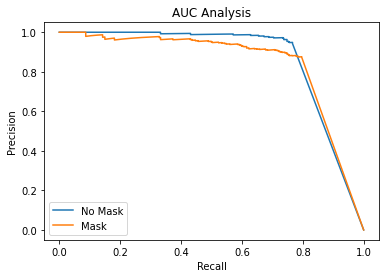

Overall Test Set 545: Precision- 0.8996282527881041, Recall- 0.8240635641316686, F1- 0.8601895734597156, GT- 926
No Mask AP:  0.8697896232275175
Mask AP:  0.8478870532592651
Test Dataset mAP:  0.8588383382433913


In [ ]:
#@title Analyze TF Test Data

#get precision and recall across the test set
Precision = all_TP/(all_TP + all_FP)
Recall = all_TP/(all_TP + all_FN)
F1 = 2 * (Precision * Recall) / (Precision + Recall)

#other
nomask = rm_empty(nomask)
mask = rm_empty(mask)

#calculate precision and recall only if have detections
if nomask and mask:
  nomask_recall, nomask_precision = recall_prec(nomask, all_nomask_GT)
  mask_recall, mask_precision = recall_prec(mask, all_mask_GT)
  #approximate the AP by AUC
  nomask_AP = metrics.auc(nomask_recall, nomask_precision)
  mask_AP = metrics.auc(mask_recall, mask_precision)

  plt.plot(nomask_recall, nomask_precision, mask_recall, mask_precision)
  plt.xlabel("Recall")
  plt.ylabel("Precision")
  plt.title("AUC Analysis")
  plt.legend(["No Mask", "Mask"])
  plt.show()
  print("Overall Test Set {0}: Precision- {1}, Recall- {2}, F1- {3}, GT- {4}".format(num_test, Precision, Recall, F1, all_GT))
  print("No Mask AP: ", nomask_AP)
  print("Mask AP: ", mask_AP)
  print("Test Dataset mAP: ", np.mean((nomask_AP, mask_AP)))
else:
  print("Need more detections of each class.")

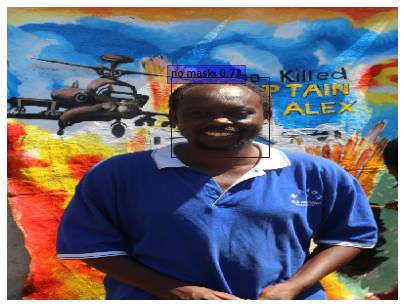

Test Image 1: TP- 1, FP- 0, FN- 0, GT- 1


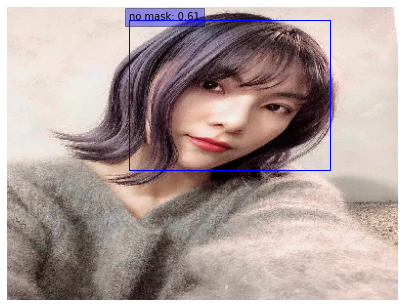

Test Image 2: TP- 1, FP- 0, FN- 0, GT- 1


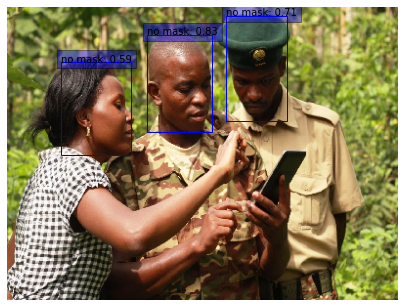

Test Image 3: TP- 3, FP- 0, FN- 0, GT- 3


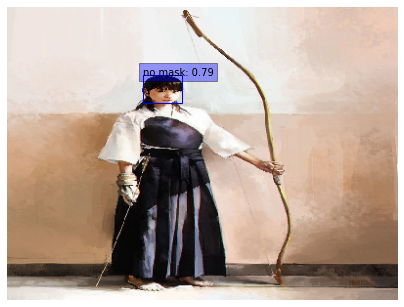

Test Image 4: TP- 1, FP- 0, FN- 0, GT- 1


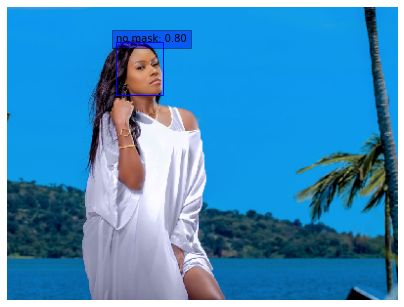

Test Image 5: TP- 1, FP- 0, FN- 0, GT- 1


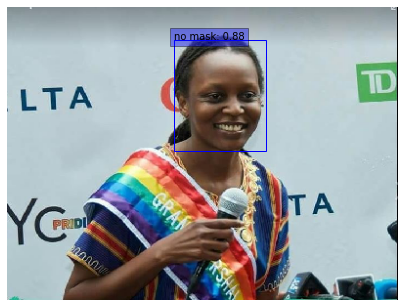

Test Image 6: TP- 1, FP- 0, FN- 0, GT- 1


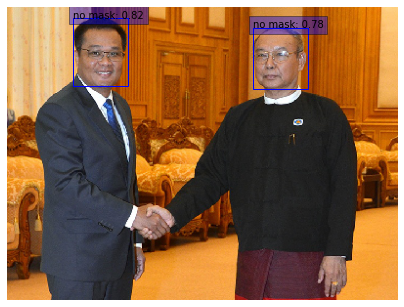

Test Image 7: TP- 2, FP- 0, FN- 0, GT- 2


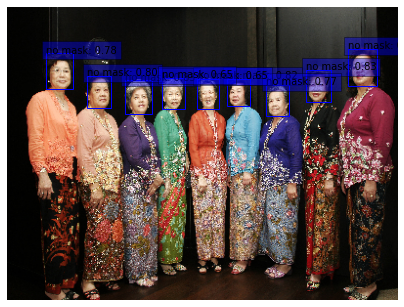

Test Image 8: TP- 9, FP- 0, FN- 0, GT- 9


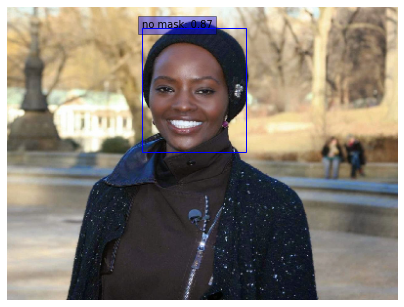

Test Image 9: TP- 1, FP- 0, FN- 0, GT- 1


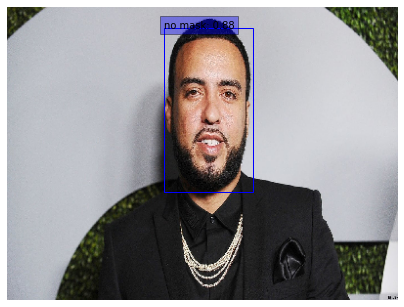

Test Image 10: TP- 1, FP- 0, FN- 0, GT- 1


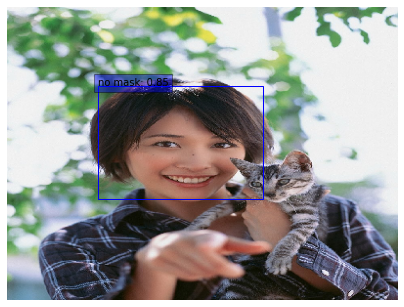

Test Image 11: TP- 1, FP- 0, FN- 0, GT- 1


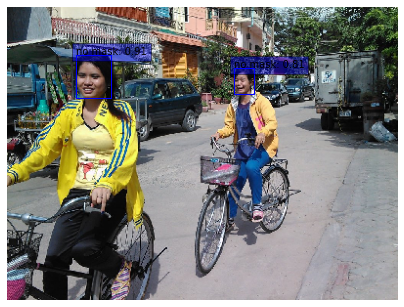

Test Image 12: TP- 2, FP- 0, FN- 0, GT- 2


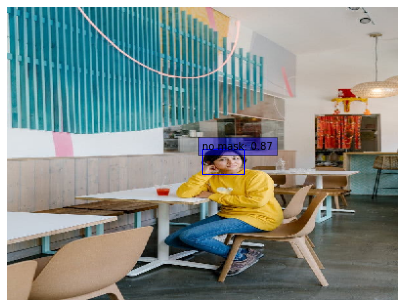

Test Image 13: TP- 1, FP- 0, FN- 0, GT- 1


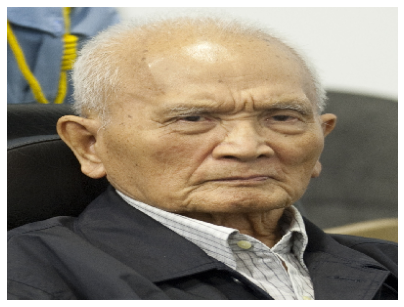

Test Image 14: TP- 0, FP- 0, FN- 1, GT- 1


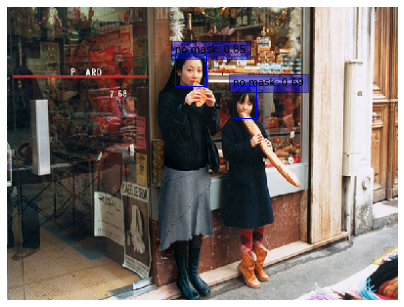

Test Image 15: TP- 2, FP- 0, FN- 0, GT- 2


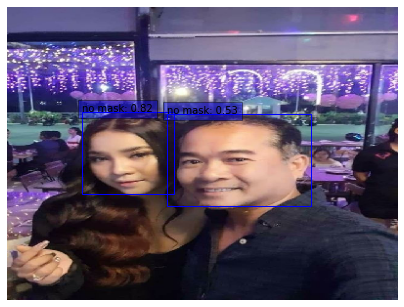

Test Image 16: TP- 2, FP- 0, FN- 0, GT- 2


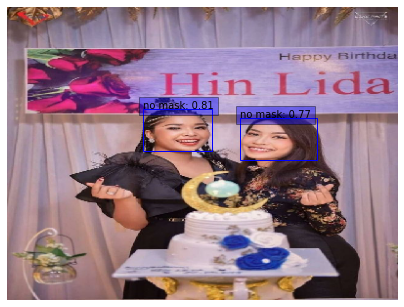

Test Image 17: TP- 2, FP- 0, FN- 0, GT- 2


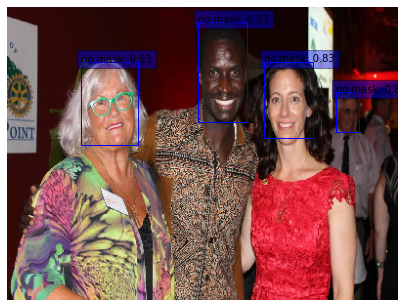

Test Image 18: TP- 4, FP- 0, FN- 0, GT- 4


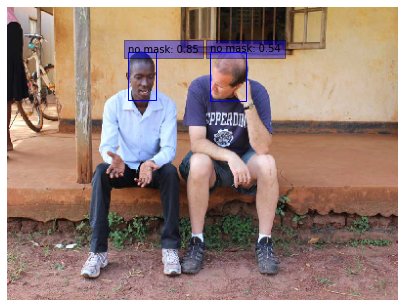

Test Image 19: TP- 2, FP- 0, FN- 0, GT- 2


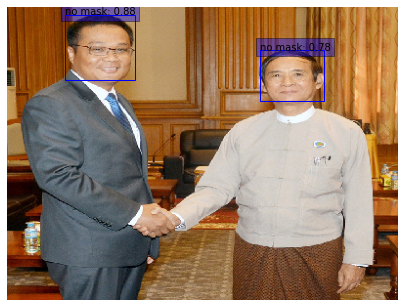

Test Image 20: TP- 2, FP- 0, FN- 0, GT- 2


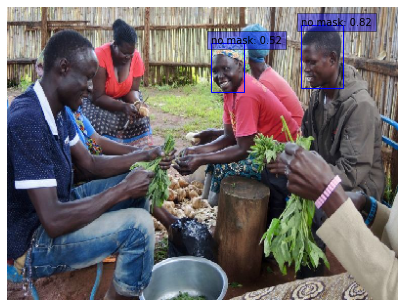

Test Image 21: TP- 2, FP- 0, FN- 2, GT- 4


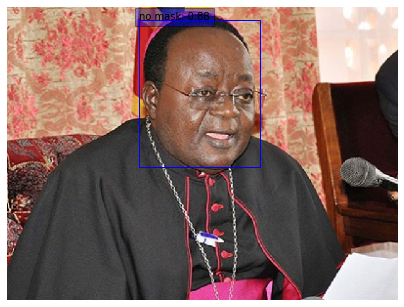

Test Image 22: TP- 1, FP- 0, FN- 0, GT- 1


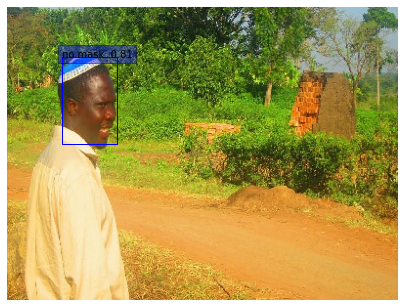

Test Image 23: TP- 1, FP- 0, FN- 0, GT- 1


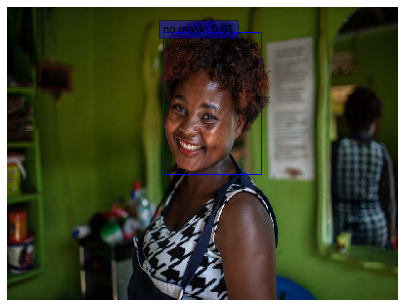

Test Image 24: TP- 1, FP- 0, FN- 0, GT- 1


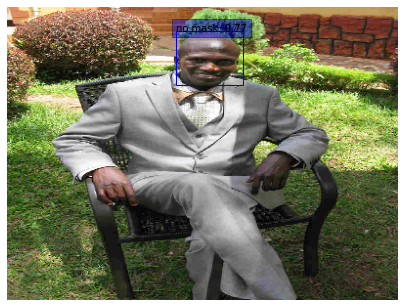

Test Image 25: TP- 1, FP- 0, FN- 0, GT- 1


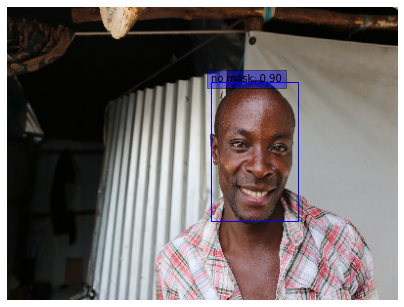

Test Image 26: TP- 1, FP- 0, FN- 0, GT- 1


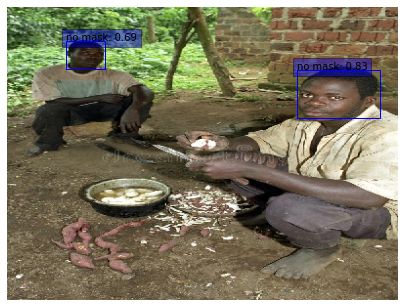

Test Image 27: TP- 2, FP- 0, FN- 0, GT- 2


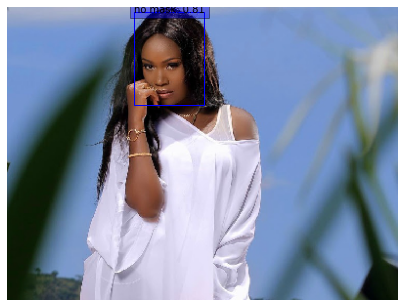

Test Image 28: TP- 1, FP- 0, FN- 0, GT- 1


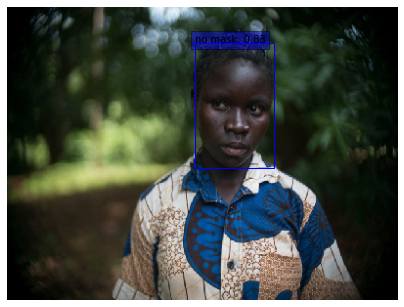

Test Image 29: TP- 1, FP- 0, FN- 0, GT- 1


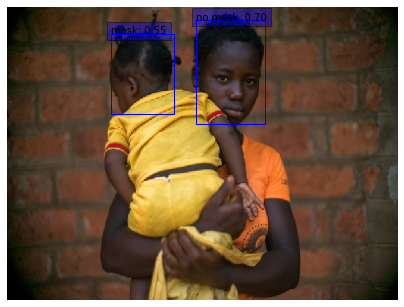

Test Image 30: TP- 1, FP- 1, FN- 0, GT- 2


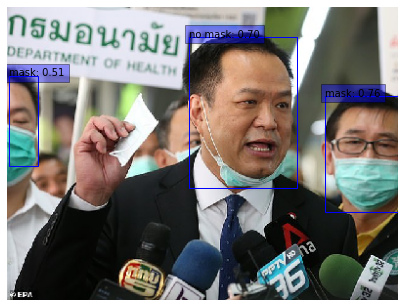

Test Image 31: TP- 2, FP- 1, FN- 1, GT- 4


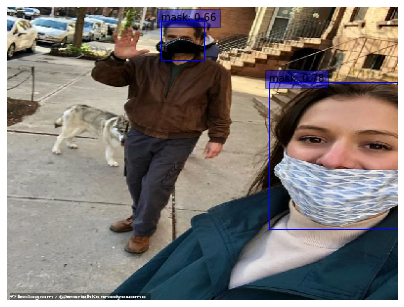

Test Image 32: TP- 0, FP- 2, FN- 0, GT- 1


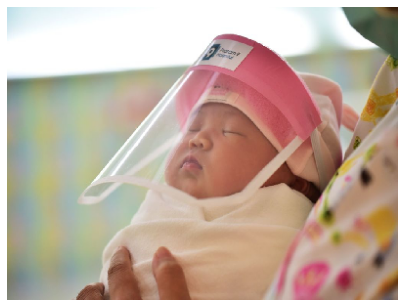

Test Image 33: TP- 0, FP- 0, FN- 1, GT- 1


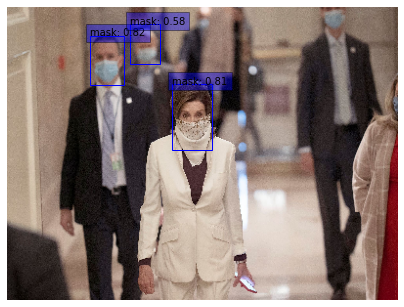

Test Image 34: TP- 2, FP- 1, FN- 1, GT- 4


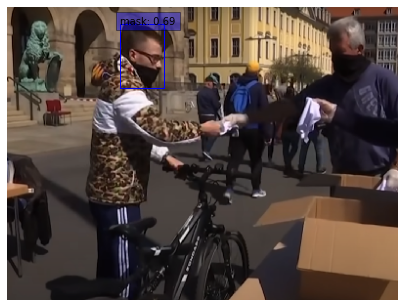

Test Image 35: TP- 0, FP- 1, FN- 0, GT- 1


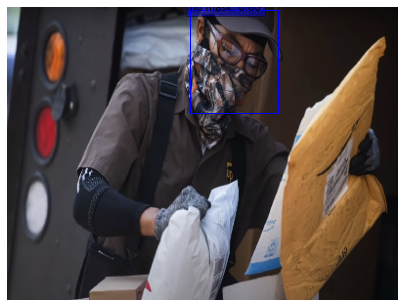

Test Image 36: TP- 1, FP- 0, FN- 0, GT- 1


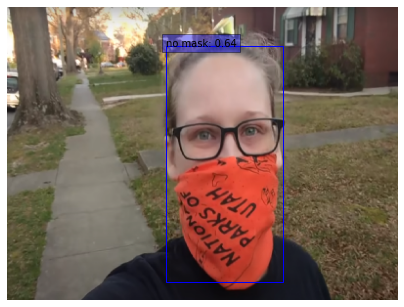

Test Image 37: TP- 1, FP- 0, FN- 0, GT- 1


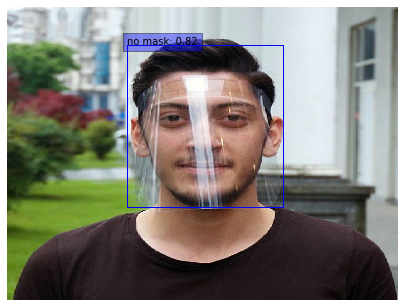

Test Image 38: TP- 1, FP- 0, FN- 0, GT- 1


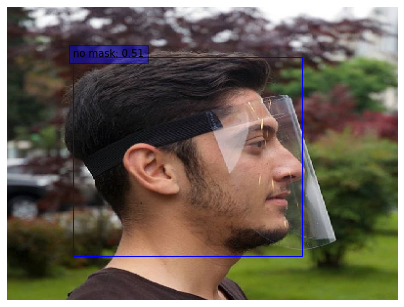

Test Image 39: TP- 1, FP- 0, FN- 0, GT- 1


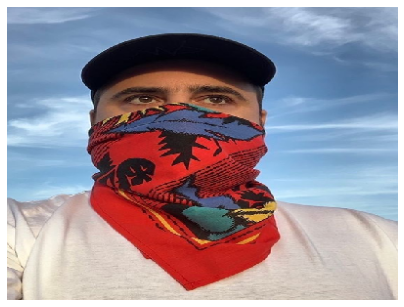

Test Image 40: TP- 0, FP- 0, FN- 1, GT- 1


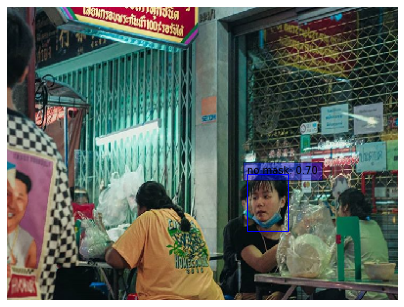

Test Image 41: TP- 1, FP- 0, FN- 0, GT- 1


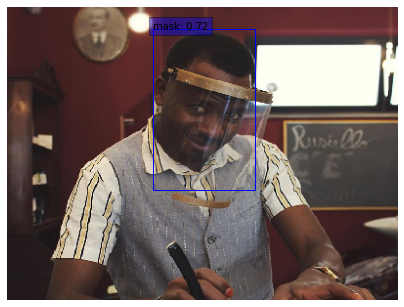

Test Image 42: TP- 0, FP- 1, FN- 0, GT- 1


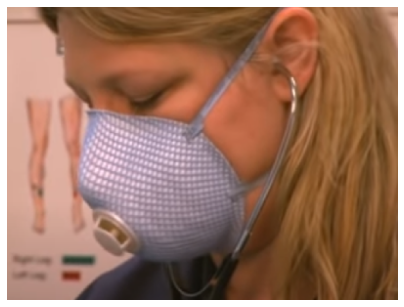

Test Image 43: TP- 0, FP- 0, FN- 1, GT- 1


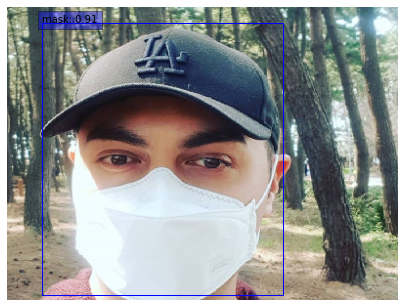

Test Image 44: TP- 1, FP- 0, FN- 0, GT- 1


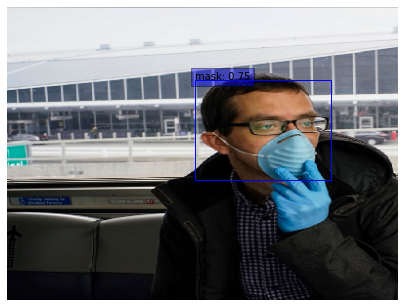

Test Image 45: TP- 1, FP- 0, FN- 0, GT- 1


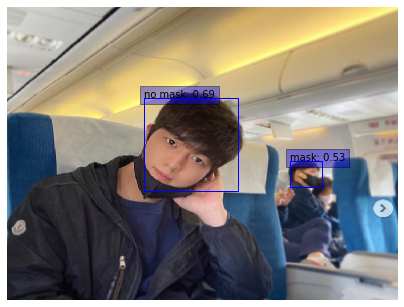

Test Image 46: TP- 1, FP- 1, FN- 0, GT- 1


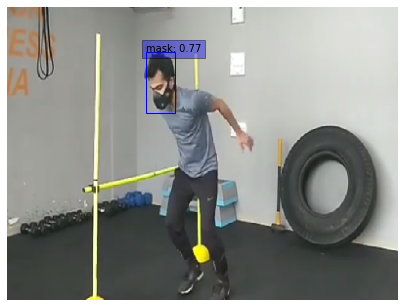

Test Image 47: TP- 1, FP- 0, FN- 0, GT- 1


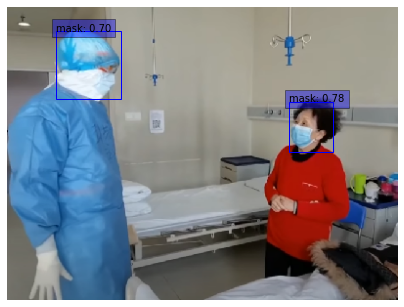

Test Image 48: TP- 2, FP- 0, FN- 0, GT- 2


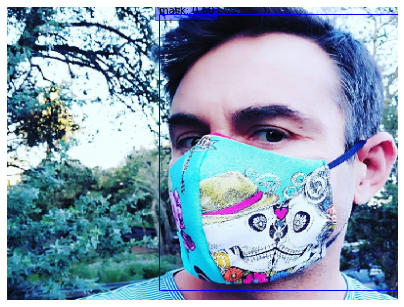

Test Image 49: TP- 1, FP- 0, FN- 0, GT- 1


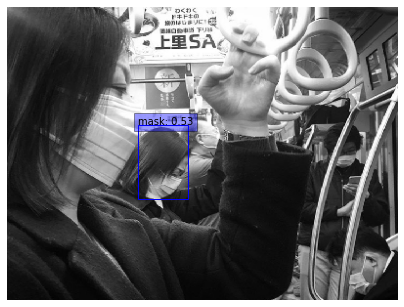

Test Image 50: TP- 1, FP- 0, FN- 4, GT- 5


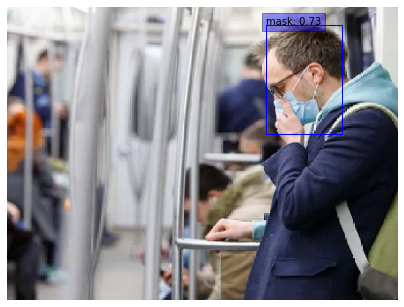

Test Image 51: TP- 1, FP- 0, FN- 0, GT- 1


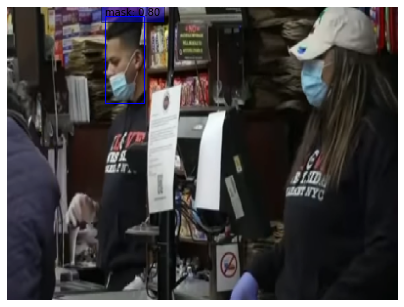

Test Image 52: TP- 0, FP- 1, FN- 0, GT- 1


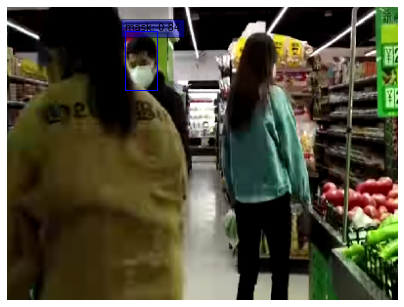

Test Image 53: TP- 1, FP- 0, FN- 0, GT- 1


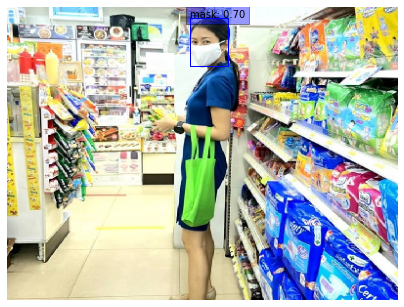

Test Image 54: TP- 1, FP- 0, FN- 0, GT- 1


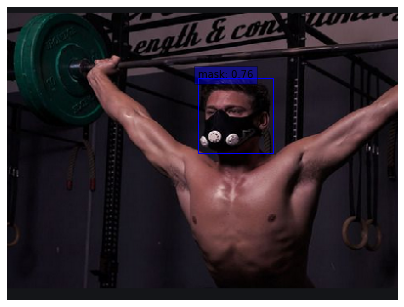

Test Image 55: TP- 1, FP- 0, FN- 0, GT- 1


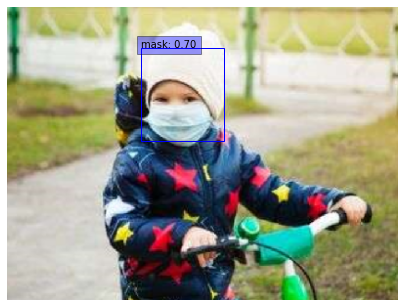

Test Image 56: TP- 1, FP- 0, FN- 0, GT- 1


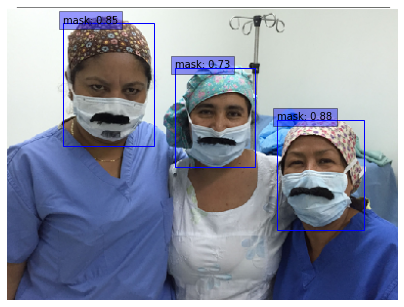

Test Image 57: TP- 2, FP- 1, FN- 0, GT- 2


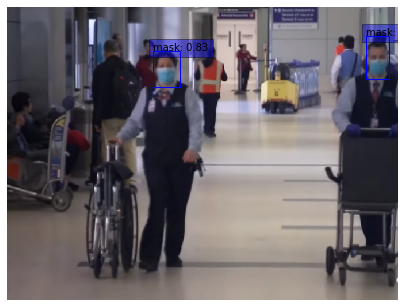

Test Image 58: TP- 2, FP- 0, FN- 0, GT- 2


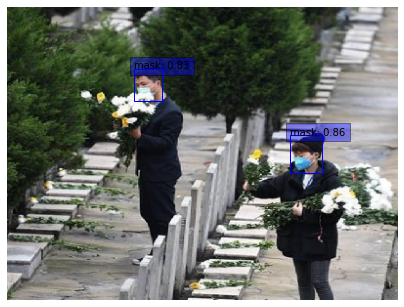

Test Image 59: TP- 2, FP- 0, FN- 0, GT- 2


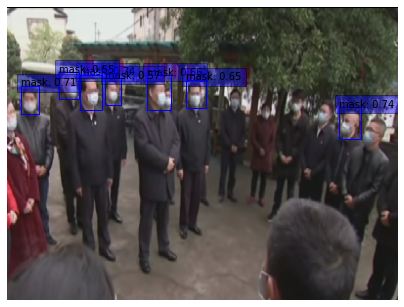

Test Image 60: TP- 7, FP- 0, FN- 6, GT- 13


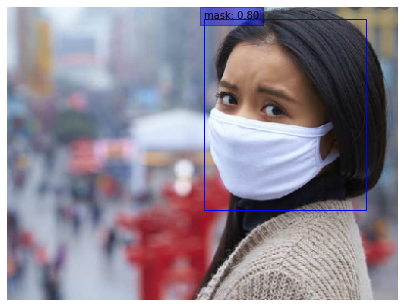

Test Image 61: TP- 1, FP- 0, FN- 0, GT- 1


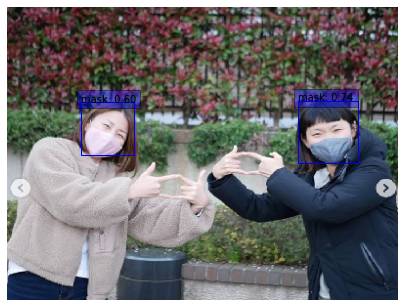

Test Image 62: TP- 2, FP- 0, FN- 0, GT- 2


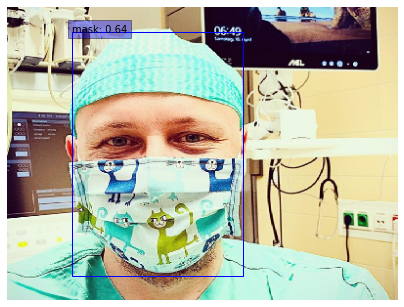

Test Image 63: TP- 1, FP- 0, FN- 0, GT- 1


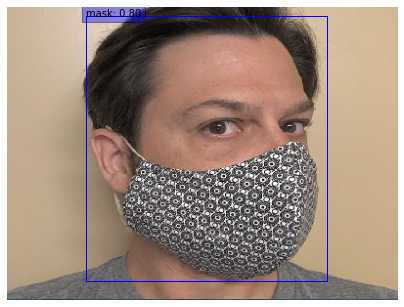

Test Image 64: TP- 1, FP- 0, FN- 0, GT- 1


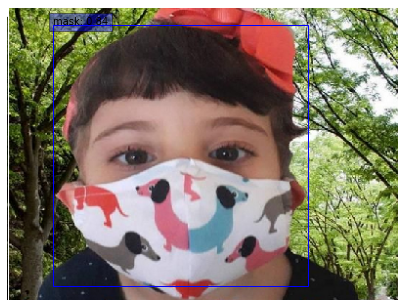

Test Image 65: TP- 1, FP- 0, FN- 0, GT- 1


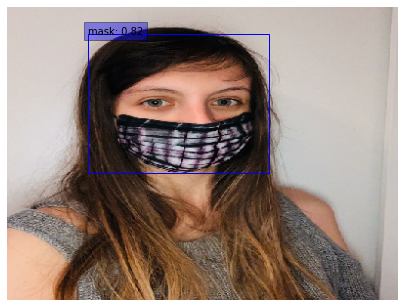

Test Image 66: TP- 1, FP- 0, FN- 0, GT- 1


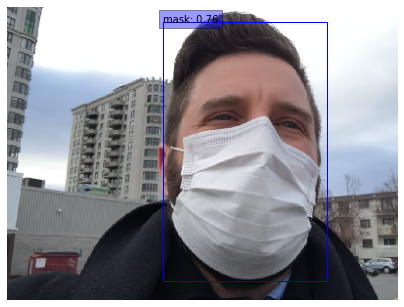

Test Image 67: TP- 1, FP- 0, FN- 0, GT- 1


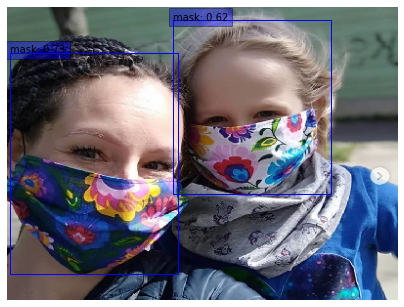

Test Image 68: TP- 2, FP- 0, FN- 0, GT- 2


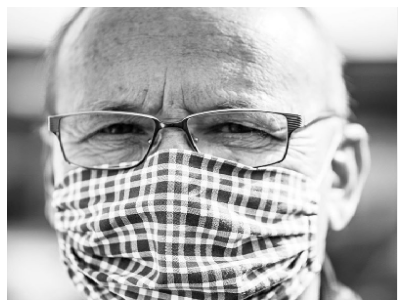

Test Image 69: TP- 0, FP- 0, FN- 1, GT- 1


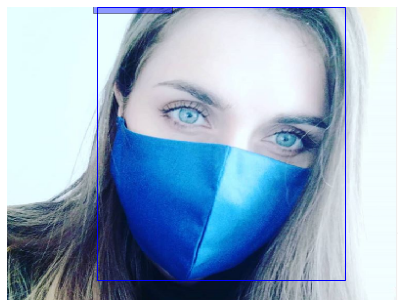

Test Image 70: TP- 0, FP- 1, FN- 0, GT- 1


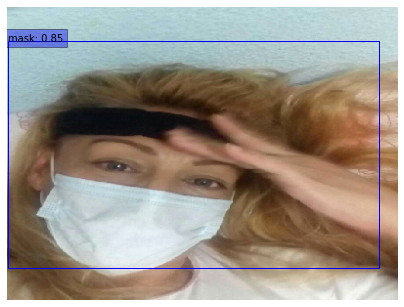

Test Image 71: TP- 0, FP- 1, FN- 0, GT- 1


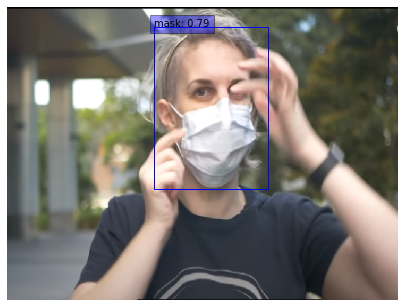

Test Image 72: TP- 1, FP- 0, FN- 0, GT- 1


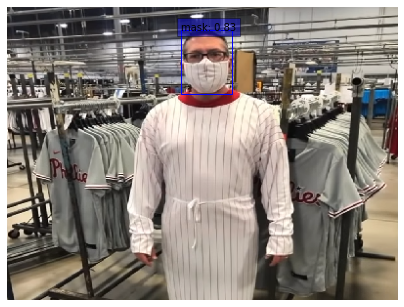

Test Image 73: TP- 1, FP- 0, FN- 0, GT- 1


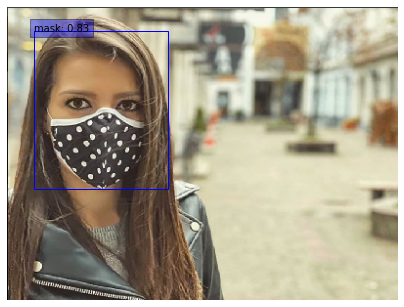

Test Image 74: TP- 1, FP- 0, FN- 0, GT- 1


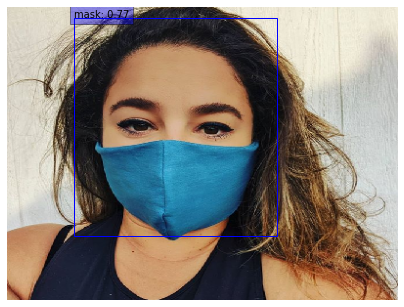

Test Image 75: TP- 1, FP- 0, FN- 0, GT- 1


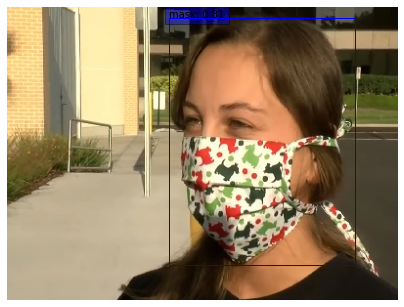

Test Image 76: TP- 1, FP- 0, FN- 0, GT- 1


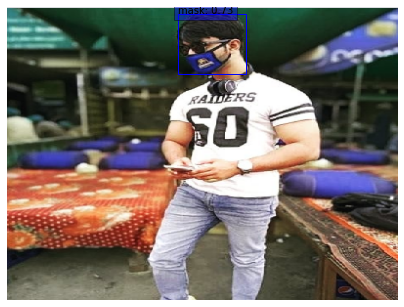

Test Image 77: TP- 1, FP- 0, FN- 0, GT- 1


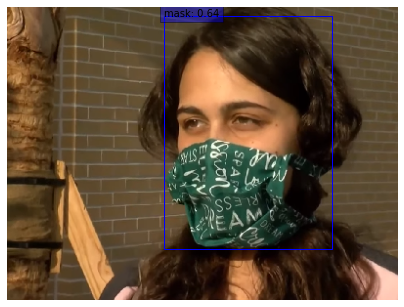

Test Image 78: TP- 1, FP- 0, FN- 0, GT- 1


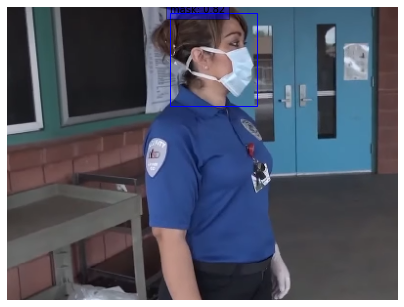

Test Image 79: TP- 1, FP- 0, FN- 0, GT- 1


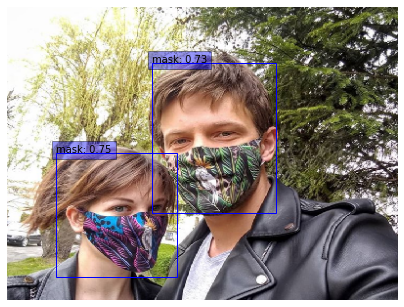

Test Image 80: TP- 2, FP- 0, FN- 0, GT- 2


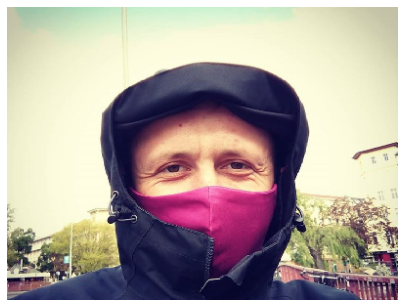

Test Image 81: TP- 0, FP- 0, FN- 1, GT- 1


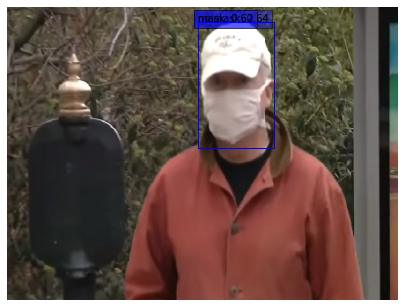

Test Image 82: TP- 1, FP- 1, FN- 0, GT- 1


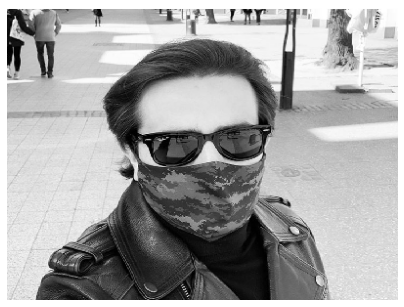

Test Image 83: TP- 0, FP- 0, FN- 1, GT- 1


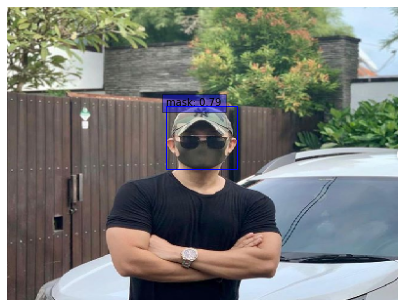

Test Image 84: TP- 1, FP- 0, FN- 0, GT- 1


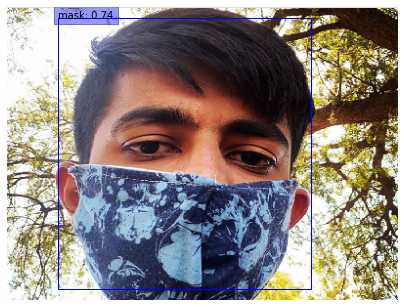

Test Image 85: TP- 1, FP- 0, FN- 0, GT- 1


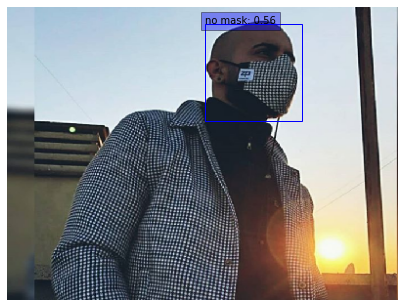

Test Image 86: TP- 0, FP- 1, FN- 0, GT- 1


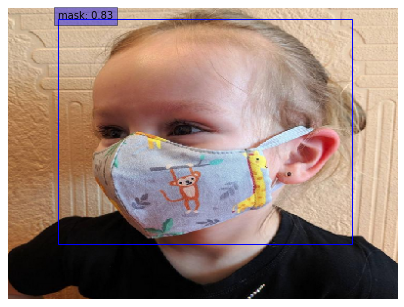

Test Image 87: TP- 1, FP- 0, FN- 0, GT- 1


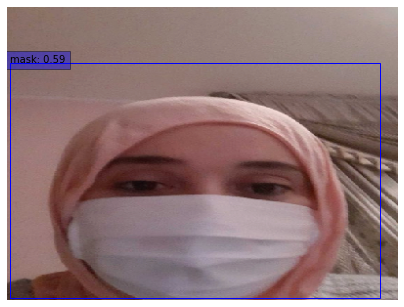

Test Image 88: TP- 1, FP- 0, FN- 0, GT- 1


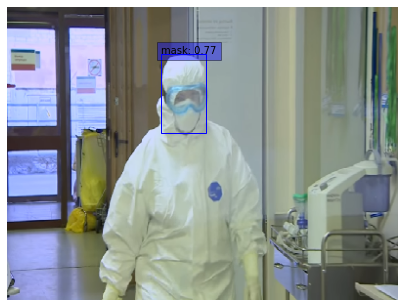

Test Image 89: TP- 1, FP- 0, FN- 0, GT- 1


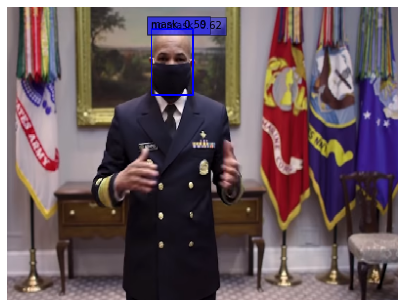

Test Image 90: TP- 1, FP- 1, FN- 0, GT- 1


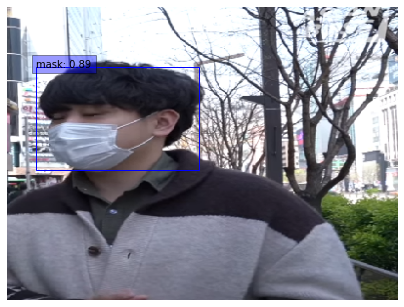

Test Image 91: TP- 1, FP- 0, FN- 0, GT- 1


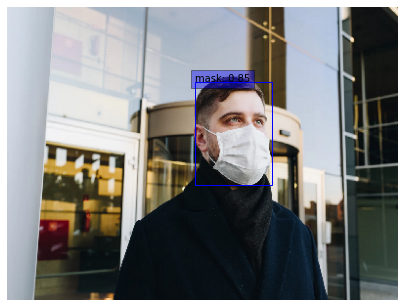

Test Image 92: TP- 1, FP- 0, FN- 0, GT- 1


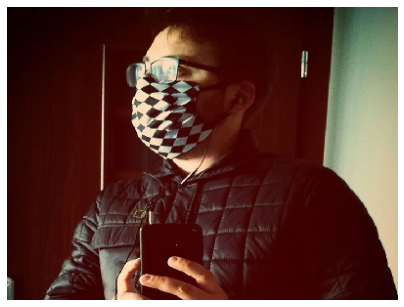

Test Image 93: TP- 0, FP- 0, FN- 1, GT- 1


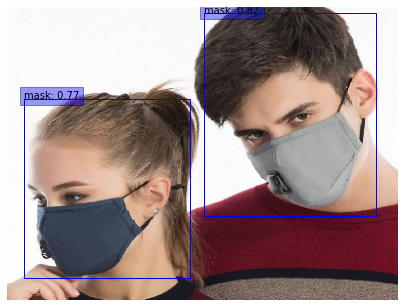

Test Image 94: TP- 2, FP- 0, FN- 0, GT- 2


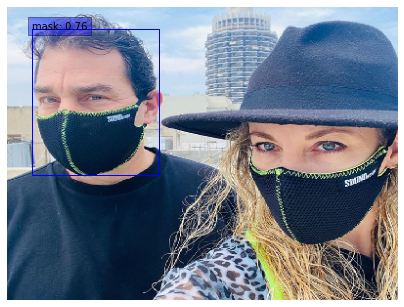

Test Image 95: TP- 1, FP- 0, FN- 1, GT- 2


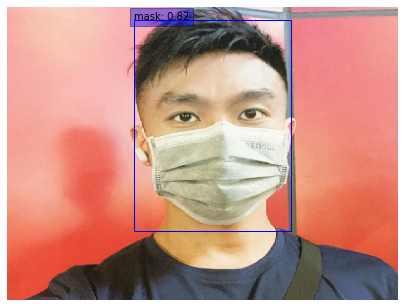

Test Image 96: TP- 1, FP- 0, FN- 0, GT- 1


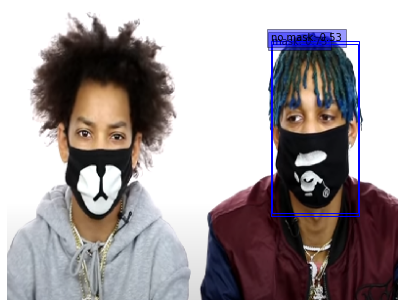

Test Image 97: TP- 1, FP- 1, FN- 0, GT- 2


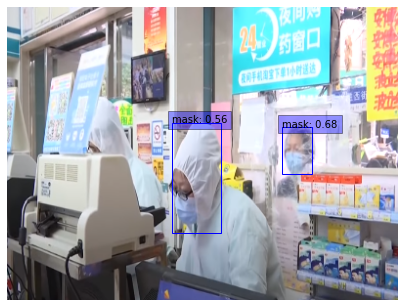

Test Image 98: TP- 2, FP- 0, FN- 0, GT- 2


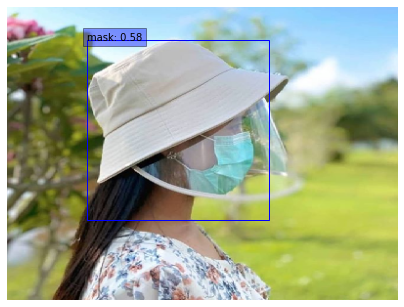

Test Image 99: TP- 1, FP- 0, FN- 0, GT- 1


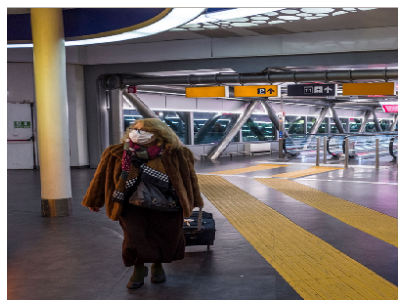

Test Image 100: TP- 0, FP- 0, FN- 1, GT- 1


In [ ]:
#@title Model Inference on TF Eval Data
#https://scikit-learn.org/stable/modules/generated/sklearn.metrics.auc.html
#https://github.com/rafaelpadilla/Object-Detection-Metrics#different-competitions-different-metrics

#prepare model inference
conf_thresh = 0.5 #@param {type: 'number'}
image = tf.keras.Input(shape=[None, None, 3], name="image")
predictions = model(image, training=False)
detections = DecodePredictions(confidence_threshold=conf_thresh)(image, predictions)
inference_model = tf.keras.Model(inputs=image, outputs=detections)
condition_key = ["no mask", "mask"]

def prepare_image(image):
    image, _, ratio = resize_and_pad_image(image, jitter=None)
    image = tf.keras.applications.resnet.preprocess_input(image)
    return tf.expand_dims(image, axis=0), ratio

num_test =  100#@param {type: 'number'}
visualize_images = True #@param ["False", "True"] {type:"raw"}

#collect metrics
all_TP = 0
all_FP = 0
all_FN = 0
all_GT = 0
all_nomask_GT = 0
all_mask_GT = 0
count = 1
nomask = []
mask = []

for sample in eval_dataset.take(num_test):
    image = tf.cast(sample["image"], dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    num_detections = detections.valid_detections[0]
    if visualize_images == True:
      class_names = [
          condition_key[int(x)] for x in detections.nmsed_classes[0][:num_detections]
      ]
      visualize_detections(
          image,
          detections.nmsed_boxes[0][:num_detections] / ratio,
          class_names,
          detections.nmsed_scores[0][:num_detections],
      )
    TP, FP, FN, num_GT, nomask_GT, mask_GT, metrics_nomask, metrics_mask = eval_metrics(sample, detections, ratio, image, num_detections, iou_thresh = 0.5)

    all_TP = all_TP + TP
    all_FP = all_FP + FP
    all_FN = all_FN + FN
    all_GT = all_GT + num_GT
    all_nomask_GT = all_nomask_GT + nomask_GT
    all_mask_GT = all_mask_GT + mask_GT

    if visualize_images == True:
      print("Test Image {0}: TP- {1}, FP- {2}, FN- {3}, GT- {4}".format(count, TP, FP, FN, num_GT))
    count = count + 1
    #only empty if lists are not empty
    nomask.append(metrics_nomask)
    mask.append(metrics_mask)

    #other
    nomask = rm_empty(nomask)
    mask = rm_empty(mask)



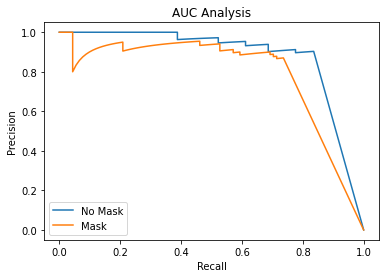

Overall Eval Set 100: Precision- 0.8848920863309353, Recall- 0.8367346938775511, F1- 0.8601398601398601, GT- 158
No Mask AP:  0.8820920884662392
Mask AP:  0.7930643628042621
Eval Dataset mAP:  0.8375782256352506


In [ ]:
#@title Analyze TF Eval Data

#get precision and recall across the test set
Precision = all_TP/(all_TP + all_FP)
Recall = all_TP/(all_TP + all_FN)
F1 = 2 * (Precision * Recall) / (Precision + Recall)

#other
nomask = rm_empty(nomask)
mask = rm_empty(mask)

#calculate precision and recall only if have detections
if nomask and mask:
  nomask_recall, nomask_precision = recall_prec(nomask, all_nomask_GT)
  mask_recall, mask_precision = recall_prec(mask, all_mask_GT)
  #approximate the AP by AUC
  nomask_AP = metrics.auc(nomask_recall, nomask_precision)
  mask_AP = metrics.auc(mask_recall, mask_precision)

  plt.plot(nomask_recall, nomask_precision, mask_recall, mask_precision)
  plt.xlabel("Recall")
  plt.ylabel("Precision")
  plt.title("AUC Analysis")
  plt.legend(["No Mask", "Mask"])
  plt.show()
  print("Overall Eval Set {0}: Precision- {1}, Recall- {2}, F1- {3}, GT- {4}".format(num_test, Precision, Recall, F1, all_GT))
  print("No Mask AP: ", nomask_AP)
  print("Mask AP: ", mask_AP)
  print("Eval Dataset mAP: ", np.mean((nomask_AP, mask_AP)))
else:
  print("Need more detections of each class.")

# Real Time Mask Detection (Run on Local Jupyter Notebook)

1. conda activate ECE_2195
2. pip install jupyter_http_over_ws
3. conda install -c conda-forge jupyter_nbextensions_configurator
4. jupyter serverextension enable -- py jupyter_http_over_ws
5. jupyter notebook --NotebookApp.allow_origin='https://colab.research.google.com' --port=8892 --NotebookApp.port_retries=0

In [ ]:
#@title Real Time Library Imports
#detect_mask_video.py
# import the necessary packages
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from imutils import paths
import matplotlib.pyplot as plt
import numpy as np
import os

# import the necessary packages
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.models import load_model
from imutils.video import WebcamVideoStream
import imutils
import time
import cv2
import time


#imports
import os
import re
import zipfile
import pandas as pd
import tensorflow as tf
from tensorflow import keras
#%matplotlib
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
import collections
from collections import Counter
import json

In [ ]:
#@title Build RetinaNet Model
#Build the RetinaNet model from Keras
#https://keras.io/examples/vision/retinanet/
#Use existing webcam script
#https://github.com/chandrikadeb7/Face-Mask-Detection
def swap_xy(boxes):
    """Swaps order the of x and y coordinates of the boxes.

    Arguments:
      boxes: A tensor with shape `(num_boxes, 4)` representing bounding boxes.

    Returns:
      swapped boxes with shape same as that of boxes.
    """
    return tf.stack([boxes[:, 1], boxes[:, 0], boxes[:, 3], boxes[:, 2]], axis=-1)


def convert_to_xywh(boxes):
    """Changes the box format to center, width and height.

    Arguments:
      boxes: A tensor of rank 2 or higher with a shape of `(..., num_boxes, 4)`
        representing bounding boxes where each box is of the format
        `[xmin, ymin, xmax, ymax]`.

    Returns:
      converted boxes with shape same as that of boxes.
    """
    return tf.concat(
        [(boxes[..., :2] + boxes[..., 2:]) / 2.0, boxes[..., 2:] - boxes[..., :2]],
        axis=-1,
    )


def convert_to_corners(boxes):
    """Changes the box format to corner coordinates

    Arguments:
      boxes: A tensor of rank 2 or higher with a shape of `(..., num_boxes, 4)`
        representing bounding boxes where each box is of the format
        `[x, y, width, height]`.

    Returns:
      converted boxes with shape same as that of boxes.
    """
    return tf.concat(
        [boxes[..., :2] - boxes[..., 2:] / 2.0, boxes[..., :2] + boxes[..., 2:] / 2.0],
        axis=-1,
    )

def compute_iou(boxes1, boxes2):
    """Computes pairwise IOU matrix for given two sets of boxes

    Arguments:
      boxes1: A tensor with shape `(N, 4)` representing bounding boxes
        where each box is of the format `[x, y, width, height]`.
        boxes2: A tensor with shape `(M, 4)` representing bounding boxes
        where each box is of the format `[x, y, width, height]`.

    Returns:
      pairwise IOU matrix with shape `(N, M)`, where the value at ith row
        jth column holds the IOU between ith box and jth box from
        boxes1 and boxes2 respectively.
    """
    boxes1_corners = convert_to_corners(boxes1)
    boxes2_corners = convert_to_corners(boxes2)
    lu = tf.maximum(boxes1_corners[:, None, :2], boxes2_corners[:, :2])
    rd = tf.minimum(boxes1_corners[:, None, 2:], boxes2_corners[:, 2:])
    intersection = tf.maximum(0.0, rd - lu)
    intersection_area = intersection[:, :, 0] * intersection[:, :, 1]
    boxes1_area = boxes1[:, 2] * boxes1[:, 3]
    boxes2_area = boxes2[:, 2] * boxes2[:, 3]
    union_area = tf.maximum(
        boxes1_area[:, None] + boxes2_area - intersection_area, 1e-8
    )
    return tf.clip_by_value(intersection_area / union_area, 0.0, 1.0)


def visualize_detections(
    image, boxes, classes, scores, figsize=(7, 7), linewidth=1, color=[0, 0, 1]
):
    """Visualize Detections"""
    image = np.array(image, dtype=np.uint8)
    plt.figure(figsize=figsize)
    plt.axis("off")
    plt.imshow(image)
    ax = plt.gca()
    for box, _cls, score in zip(boxes, classes, scores):
        text = "{}: {:.2f}".format(_cls, score)
        x1, y1, x2, y2 = box
        w, h = x2 - x1, y2 - y1
        patch = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color, linewidth=linewidth
        )
        ax.add_patch(patch)
        ax.text(
            x1,
            y1,
            text,
            bbox={"facecolor": color, "alpha": 0.4},
            clip_box=ax.clipbox,
            clip_on=True,
        )
    plt.show()
    return ax

class AnchorBox:
    """Generates anchor boxes.

    This class has operations to generate anchor boxes for feature maps at
    strides `[8, 16, 32, 64, 128]`. Where each anchor each box is of the
    format `[x, y, width, height]`.

    Attributes:
      aspect_ratios: A list of float values representing the aspect ratios of
        the anchor boxes at each location on the feature map
      scales: A list of float values representing the scale of the anchor boxes
        at each location on the feature map.
      num_anchors: The number of anchor boxes at each location on feature map
      areas: A list of float values representing the areas of the anchor
        boxes for each feature map in the feature pyramid.
      strides: A list of float value representing the strides for each feature
        map in the feature pyramid.
    """

    def __init__(self):
        self.aspect_ratios = [0.5, 1.0, 2.0]
        self.scales = [2 ** x for x in [0, 1 / 3, 2 / 3]]

        self._num_anchors = len(self.aspect_ratios) * len(self.scales)
        self._strides = [2 ** i for i in range(3, 8)]
        self._areas = [x ** 2 for x in [32.0, 64.0, 128.0, 256.0, 512.0]]
        self._anchor_dims = self._compute_dims()

    def _compute_dims(self):
        """Computes anchor box dimensions for all ratios and scales at all levels
        of the feature pyramid.
        """
        anchor_dims_all = []
        for area in self._areas:
            anchor_dims = []
            for ratio in self.aspect_ratios:
                anchor_height = tf.math.sqrt(area / ratio)
                anchor_width = area / anchor_height
                dims = tf.reshape(
                    tf.stack([anchor_width, anchor_height], axis=-1), [1, 1, 2]
                )
                for scale in self.scales:
                    anchor_dims.append(scale * dims)
            anchor_dims_all.append(tf.stack(anchor_dims, axis=-2))
        return anchor_dims_all

    def _get_anchors(self, feature_height, feature_width, level):
        """Generates anchor boxes for a given feature map size and level

        Arguments:
          feature_height: An integer representing the height of the feature map.
          feature_width: An integer representing the width of the feature map.
          level: An integer representing the level of the feature map in the
            feature pyramid.

        Returns:
          anchor boxes with the shape
          `(feature_height * feature_width * num_anchors, 4)`
        """
        rx = tf.range(feature_width, dtype=tf.float32) + 0.5
        ry = tf.range(feature_height, dtype=tf.float32) + 0.5
        centers = tf.stack(tf.meshgrid(rx, ry), axis=-1) * self._strides[level - 3]
        centers = tf.expand_dims(centers, axis=-2)
        centers = tf.tile(centers, [1, 1, self._num_anchors, 1])
        dims = tf.tile(
            self._anchor_dims[level - 3], [feature_height, feature_width, 1, 1]
        )
        anchors = tf.concat([centers, dims], axis=-1)
        return tf.reshape(
            anchors, [feature_height * feature_width * self._num_anchors, 4]
        )

    def get_anchors(self, image_height, image_width):
        """Generates anchor boxes for all the feature maps of the feature pyramid.

        Arguments:
          image_height: Height of the input image.
          image_width: Width of the input image.

        Returns:
          anchor boxes for all the feature maps, stacked as a single tensor
            with shape `(total_anchors, 4)`
        """
        anchors = [
            self._get_anchors(
                tf.math.ceil(image_height / 2 ** i),
                tf.math.ceil(image_width / 2 ** i),
                i,
            )
            for i in range(3, 8)
        ]
        return tf.concat(anchors, axis=0)

def random_flip_horizontal(image, boxes):
    """Flips image and boxes horizontally with 50% chance

    Arguments:
      image: A 3-D tensor of shape `(height, width, channels)` representing an
        image.
      boxes: A tensor with shape `(num_boxes, 4)` representing bounding boxes,
        having normalized coordinates.

    Returns:
      Randomly flipped image and boxes
    """
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        boxes = tf.stack(
            [1 - boxes[:, 2], boxes[:, 1], 1 - boxes[:, 0], boxes[:, 3]], axis=-1
        )
    return image, boxes


def resize_and_pad_image(
    image, min_side=800.0, max_side=1333.0, jitter=[640, 1024], stride=128.0
):
    """Resizes and pads image while preserving aspect ratio.

    1. Resizes images so that the shorter side is equal to `min_side`
    2. If the longer side is greater than `max_side`, then resize the image
      with longer side equal to `max_side`
    3. Pad with zeros on right and bottom to make the image shape divisible by
    `stride`

    Arguments:
      image: A 3-D tensor of shape `(height, width, channels)` representing an
        image.
      min_side: The shorter side of the image is resized to this value, if
        `jitter` is set to None.
      max_side: If the longer side of the image exceeds this value after
        resizing, the image is resized such that the longer side now equals to
        this value.
      jitter: A list of floats containing minimum and maximum size for scale
        jittering. If available, the shorter side of the image will be
        resized to a random value in this range.
      stride: The stride of the smallest feature map in the feature pyramid.
        Can be calculated using `image_size / feature_map_size`.

    Returns:
      image: Resized and padded image.
      image_shape: Shape of the image before padding.
      ratio: The scaling factor used to resize the image
    """
    image_shape = tf.cast(tf.shape(image)[:2], dtype=tf.float32)
    if jitter is not None:
        min_side = tf.random.uniform((), jitter[0], jitter[1], dtype=tf.float32)
    ratio = min_side / tf.reduce_min(image_shape)
    if ratio * tf.reduce_max(image_shape) > max_side:
        ratio = max_side / tf.reduce_max(image_shape)
    image_shape = ratio * image_shape
    image = tf.image.resize(image, tf.cast(image_shape, dtype=tf.int32))
    padded_image_shape = tf.cast(
        tf.math.ceil(image_shape / stride) * stride, dtype=tf.int32
    )
    image = tf.image.pad_to_bounding_box(
        image, 0, 0, padded_image_shape[0], padded_image_shape[1]
    )
    return image, image_shape, ratio


def preprocess_data(sample):
    """Applies preprocessing step to a single sample

    Arguments:
      sample: A dict representing a single training sample.

    Returns:
      image: Resized and padded image with random horizontal flipping applied.
      bbox: Bounding boxes with the shape `(num_objects, 4)` where each box is
        of the format `[x, y, width, height]`.
      class_id: An tensor representing the class id of the objects, having
        shape `(num_objects,)`.
    """
    image = sample["image"]
    bbox = swap_xy(sample["objects"]["bbox"])
    class_id = tf.cast(sample["objects"]["label"], dtype=tf.int32)

    image, bbox = random_flip_horizontal(image, bbox)
    image, image_shape, _ = resize_and_pad_image(image)

    bbox = tf.stack(
        [
            bbox[:, 0] * image_shape[1],
            bbox[:, 1] * image_shape[0],
            bbox[:, 2] * image_shape[1],
            bbox[:, 3] * image_shape[0],
        ],
        axis=-1,
    )
    bbox = convert_to_xywh(bbox)
    return image, bbox, class_id

class LabelEncoder:
    """Transforms the raw labels into targets for training.

    This class has operations to generate targets for a batch of samples which
    is made up of the input images, bounding boxes for the objects present and
    their class ids.

    Attributes:
      anchor_box: Anchor box generator to encode the bounding boxes.
      box_variance: The scaling factors used to scale the bounding box targets.
    """

    def __init__(self):
        self._anchor_box = AnchorBox()
        self._box_variance = tf.convert_to_tensor(
            [0.1, 0.1, 0.2, 0.2], dtype=tf.float32
        )

    def _match_anchor_boxes(
        self, anchor_boxes, gt_boxes, match_iou=0.5, ignore_iou=0.4
    ):
        """Matches ground truth boxes to anchor boxes based on IOU.

        1. Calculates the pairwise IOU for the M `anchor_boxes` and N `gt_boxes`
          to get a `(M, N)` shaped matrix.
        2. The ground truth box with the maximum IOU in each row is assigned to
          the anchor box provided the IOU is greater than `match_iou`.
        3. If the maximum IOU in a row is less than `ignore_iou`, the anchor
          box is assigned with the background class.
        4. The remaining anchor boxes that do not have any class assigned are
          ignored during training.

        Arguments:
          anchor_boxes: A float tensor with the shape `(total_anchors, 4)`
            representing all the anchor boxes for a given input image shape,
            where each anchor box is of the format `[x, y, width, height]`.
          gt_boxes: A float tensor with shape `(num_objects, 4)` representing
            the ground truth boxes, where each box is of the format
            `[x, y, width, height]`.
          match_iou: A float value representing the minimum IOU threshold for
            determining if a ground truth box can be assigned to an anchor box.
          ignore_iou: A float value representing the IOU threshold under which
            an anchor box is assigned to the background class.

        Returns:
          matched_gt_idx: Index of the matched object
          positive_mask: A mask for anchor boxes that have been assigned ground
            truth boxes.
          ignore_mask: A mask for anchor boxes that need to by ignored during
            training
        """
        iou_matrix = compute_iou(anchor_boxes, gt_boxes)
        max_iou = tf.reduce_max(iou_matrix, axis=1)
        matched_gt_idx = tf.argmax(iou_matrix, axis=1)
        positive_mask = tf.greater_equal(max_iou, match_iou)
        negative_mask = tf.less(max_iou, ignore_iou)
        ignore_mask = tf.logical_not(tf.logical_or(positive_mask, negative_mask))
        return (
            matched_gt_idx,
            tf.cast(positive_mask, dtype=tf.float32),
            tf.cast(ignore_mask, dtype=tf.float32),
        )

    def _compute_box_target(self, anchor_boxes, matched_gt_boxes):
        """Transforms the ground truth boxes into targets for training"""
        box_target = tf.concat(
            [
                (matched_gt_boxes[:, :2] - anchor_boxes[:, :2]) / anchor_boxes[:, 2:],
                tf.math.log(matched_gt_boxes[:, 2:] / anchor_boxes[:, 2:]),
            ],
            axis=-1,
        )
        box_target = box_target / self._box_variance
        return box_target

    def _encode_sample(self, image_shape, gt_boxes, cls_ids):
        """Creates box and classification targets for a single sample"""
        anchor_boxes = self._anchor_box.get_anchors(image_shape[1], image_shape[2])
        cls_ids = tf.cast(cls_ids, dtype=tf.float32)
        matched_gt_idx, positive_mask, ignore_mask = self._match_anchor_boxes(
            anchor_boxes, gt_boxes
        )
        matched_gt_boxes = tf.gather(gt_boxes, matched_gt_idx)
        box_target = self._compute_box_target(anchor_boxes, matched_gt_boxes)
        matched_gt_cls_ids = tf.gather(cls_ids, matched_gt_idx)
        cls_target = tf.where(
            tf.not_equal(positive_mask, 1.0), -1.0, matched_gt_cls_ids
        )
        cls_target = tf.where(tf.equal(ignore_mask, 1.0), -2.0, cls_target)
        cls_target = tf.expand_dims(cls_target, axis=-1)
        label = tf.concat([box_target, cls_target], axis=-1)
        return label

    def encode_batch(self, batch_images, gt_boxes, cls_ids):
        """Creates box and classification targets for a batch"""
        images_shape = tf.shape(batch_images)
        batch_size = images_shape[0]

        labels = tf.TensorArray(dtype=tf.float32, size=batch_size, dynamic_size=True)
        for i in range(batch_size):
            label = self._encode_sample(images_shape, gt_boxes[i], cls_ids[i])
            labels = labels.write(i, label)
        batch_images = tf.keras.applications.resnet.preprocess_input(batch_images)
        return batch_images, labels.stack()

def get_backbone():
    """Builds ResNet50 with pre-trained imagenet weights"""
    backbone = keras.applications.ResNet50(
        include_top=False, input_shape=[None, None, 3]
    )
    c3_output, c4_output, c5_output = [
        backbone.get_layer(layer_name).output
        for layer_name in ["conv3_block4_out", "conv4_block6_out", "conv5_block3_out"]
    ]
    return keras.Model(
        inputs=[backbone.inputs], outputs=[c3_output, c4_output, c5_output]
    )

class FeaturePyramid(keras.layers.Layer):
    """Builds the Feature Pyramid with the feature maps from the backbone.

    Attributes:
      num_classes: Number of classes in the dataset.
      backbone: The backbone to build the feature pyramid from.
        Currently supports ResNet50 only.
    """

    def __init__(self, backbone=None, **kwargs):
        super(FeaturePyramid, self).__init__(name="FeaturePyramid", **kwargs)
        self.backbone = backbone if backbone else get_backbone()
        self.conv_c3_1x1 = keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c4_1x1 = keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c5_1x1 = keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c3_3x3 = keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c4_3x3 = keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c5_3x3 = keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c6_3x3 = keras.layers.Conv2D(256, 3, 2, "same")
        self.conv_c7_3x3 = keras.layers.Conv2D(256, 3, 2, "same")
        self.upsample_2x = keras.layers.UpSampling2D(2)

    def call(self, images, training=False):
        c3_output, c4_output, c5_output = self.backbone(images, training=training)
        p3_output = self.conv_c3_1x1(c3_output)
        p4_output = self.conv_c4_1x1(c4_output)
        p5_output = self.conv_c5_1x1(c5_output)
        p4_output = p4_output + self.upsample_2x(p5_output)
        p3_output = p3_output + self.upsample_2x(p4_output)
        p3_output = self.conv_c3_3x3(p3_output)
        p4_output = self.conv_c4_3x3(p4_output)
        p5_output = self.conv_c5_3x3(p5_output)
        p6_output = self.conv_c6_3x3(c5_output)
        p7_output = self.conv_c7_3x3(tf.nn.relu(p6_output))
        return p3_output, p4_output, p5_output, p6_output, p7_output

def build_head(output_filters, bias_init):
    """Builds the class/box predictions head.

    Arguments:
      output_filters: Number of convolution filters in the final layer.
      bias_init: Bias Initializer for the final convolution layer.

    Returns:
      A keras sequential model representing either the classification
        or the box regression head depending on `output_filters`.
    """
    head = keras.Sequential([keras.Input(shape=[None, None, 256])])
    kernel_init = tf.initializers.RandomNormal(0.0, 0.01)
    for _ in range(4):
        head.add(
            keras.layers.Conv2D(256, 3, padding="same", kernel_initializer=kernel_init)
        )
        head.add(keras.layers.ReLU())
    head.add(
        keras.layers.Conv2D(
            output_filters,
            3,
            1,
            padding="same",
            kernel_initializer=kernel_init,
            bias_initializer=bias_init,
        )
    )
    return head

class RetinaNet(keras.Model):
    """A subclassed Keras model implementing the RetinaNet architecture.

    Attributes:
      num_classes: Number of classes in the dataset.
      backbone: The backbone to build the feature pyramid from.
        Currently supports ResNet50 only.
    """

    def __init__(self, num_classes, backbone=None, **kwargs):
        super(RetinaNet, self).__init__(name="RetinaNet", **kwargs)
        self.fpn = FeaturePyramid(backbone)
        self.num_classes = num_classes

        prior_probability = tf.constant_initializer(-np.log((1 - 0.01) / 0.01))
        self.cls_head = build_head(9 * num_classes, prior_probability)
        self.box_head = build_head(9 * 4, "zeros")

    def call(self, image, training=False):
        features = self.fpn(image, training=training)
        N = tf.shape(image)[0]
        cls_outputs = []
        box_outputs = []
        for feature in features:
            box_outputs.append(tf.reshape(self.box_head(feature), [N, -1, 4]))
            cls_outputs.append(
                tf.reshape(self.cls_head(feature), [N, -1, self.num_classes])
            )
        cls_outputs = tf.concat(cls_outputs, axis=1)
        box_outputs = tf.concat(box_outputs, axis=1)
        return tf.concat([box_outputs, cls_outputs], axis=-1)

class DecodePredictions(tf.keras.layers.Layer):
    """A Keras layer that decodes predictions of the RetinaNet model.

    Attributes:
      num_classes: Number of classes in the dataset
      confidence_threshold: Minimum class probability, below which detections
        are pruned.
      nms_iou_threshold: IOU threshold for the NMS operation
      max_detections_per_class: Maximum number of detections to retain per
       class.
      max_detections: Maximum number of detections to retain across all
        classes.
      box_variance: The scaling factors used to scale the bounding box
        predictions.
    """

    def __init__(
        self,
        num_classes=2,
        confidence_threshold=0.05,
        nms_iou_threshold=0.5,
        max_detections_per_class=100,
        max_detections=10,
        box_variance=[0.1, 0.1, 0.2, 0.2],
        **kwargs
    ):
        super(DecodePredictions, self).__init__(**kwargs)
        self.num_classes = num_classes
        self.confidence_threshold = confidence_threshold
        self.nms_iou_threshold = nms_iou_threshold
        self.max_detections_per_class = max_detections_per_class
        self.max_detections = max_detections

        self._anchor_box = AnchorBox()
        self._box_variance = tf.convert_to_tensor(
            [0.1, 0.1, 0.2, 0.2], dtype=tf.float32
        )

    def _decode_box_predictions(self, anchor_boxes, box_predictions):
        boxes = box_predictions * self._box_variance
        boxes = tf.concat(
            [
                boxes[:, :, :2] * anchor_boxes[:, :, 2:] + anchor_boxes[:, :, :2],
                tf.math.exp(boxes[:, :, 2:]) * anchor_boxes[:, :, 2:],
            ],
            axis=-1,
        )
        boxes_transformed = convert_to_corners(boxes)
        return boxes_transformed

    def call(self, images, predictions):
        image_shape = tf.cast(tf.shape(images), dtype=tf.float32)
        anchor_boxes = self._anchor_box.get_anchors(image_shape[1], image_shape[2])
        box_predictions = predictions[:, :, :4]
        cls_predictions = tf.nn.sigmoid(predictions[:, :, 4:])
        boxes = self._decode_box_predictions(anchor_boxes[None, ...], box_predictions)

        return tf.image.combined_non_max_suppression(
            tf.expand_dims(boxes, axis=2),
            cls_predictions,
            self.max_detections_per_class,
            self.max_detections,
            self.nms_iou_threshold,
            self.confidence_threshold,
            clip_boxes=False,
        )

class RetinaNetBoxLoss(tf.losses.Loss):
    """Implements Smooth L1 loss"""

    def __init__(self, delta):
        super(RetinaNetBoxLoss, self).__init__(
            reduction="none", name="RetinaNetBoxLoss"
        )
        self._delta = delta

    def call(self, y_true, y_pred):
        difference = y_true - y_pred
        absolute_difference = tf.abs(difference)
        squared_difference = difference ** 2
        loss = tf.where(
            tf.less(absolute_difference, self._delta),
            0.5 * squared_difference,
            absolute_difference - 0.5,
        )
        return tf.reduce_sum(loss, axis=-1)


class RetinaNetClassificationLoss(tf.losses.Loss):
    """Implements Focal loss"""

    def __init__(self, alpha, gamma):
        super(RetinaNetClassificationLoss, self).__init__(
            reduction="none", name="RetinaNetClassificationLoss"
        )
        self._alpha = alpha
        self._gamma = gamma

    def call(self, y_true, y_pred):
        cross_entropy = tf.nn.sigmoid_cross_entropy_with_logits(
            labels=y_true, logits=y_pred
        )
        probs = tf.nn.sigmoid(y_pred)
        alpha = tf.where(tf.equal(y_true, 1.0), self._alpha, (1.0 - self._alpha))
        pt = tf.where(tf.equal(y_true, 1.0), probs, 1 - probs)
        loss = alpha * tf.pow(1.0 - pt, self._gamma) * cross_entropy
        return tf.reduce_sum(loss, axis=-1)


class RetinaNetLoss(tf.losses.Loss):
    """Wrapper to combine both the losses"""

    def __init__(self, num_classes=3, alpha=0.25, gamma=2.0, delta=1.0):
        super(RetinaNetLoss, self).__init__(reduction="auto", name="RetinaNetLoss")
        self._clf_loss = RetinaNetClassificationLoss(alpha, gamma)
        self._box_loss = RetinaNetBoxLoss(delta)
        self._num_classes = num_classes

    def call(self, y_true, y_pred):
        y_pred = tf.cast(y_pred, dtype=tf.float32)
        box_labels = y_true[:, :, :4]
        box_predictions = y_pred[:, :, :4]
        cls_labels = tf.one_hot(
            tf.cast(y_true[:, :, 4], dtype=tf.int32),
            depth=self._num_classes,
            dtype=tf.float32,
        )
        cls_predictions = y_pred[:, :, 4:]
        positive_mask = tf.cast(tf.greater(y_true[:, :, 4], -1.0), dtype=tf.float32)
        ignore_mask = tf.cast(tf.equal(y_true[:, :, 4], -2.0), dtype=tf.float32)
        clf_loss = self._clf_loss(cls_labels, cls_predictions)
        box_loss = self._box_loss(box_labels, box_predictions)
        clf_loss = tf.where(tf.equal(ignore_mask, 1.0), 0.0, clf_loss)
        box_loss = tf.where(tf.equal(positive_mask, 1.0), box_loss, 0.0)
        normalizer = tf.reduce_sum(positive_mask, axis=-1)
        clf_loss = tf.math.divide_no_nan(tf.reduce_sum(clf_loss, axis=-1), normalizer)
        box_loss = tf.math.divide_no_nan(tf.reduce_sum(box_loss, axis=-1), normalizer)
        loss = clf_loss + box_loss
        return loss

model_dir = "retinanet/"
label_encoder = LabelEncoder()

num_classes = 2
batch_size = 2

learning_rates = [2.5e-06, 0.000625, 0.00125, 0.0025, 0.00025, 2.5e-05]
learning_rate_boundaries = [125, 250, 500, 240000, 360000]
learning_rate_fn = tf.optimizers.schedules.PiecewiseConstantDecay(
    boundaries=learning_rate_boundaries, values=learning_rates
)

resnet50_backbone = get_backbone()
loss_fn = RetinaNetLoss(num_classes)
model = RetinaNet(num_classes, resnet50_backbone)

optimizer = tf.optimizers.SGD(learning_rate=learning_rate_fn, momentum=0.9)
model.compile(loss=loss_fn, optimizer=optimizer)

callbacks_list = [
    tf.keras.callbacks.ModelCheckpoint(
        filepath=os.path.join(model_dir, "weights" + "_epoch_{epoch}"),
        monitor="loss",
        save_best_only=False,
        save_weights_only=True,
        verbose=1,
    )
]

model_path = "bs600_e10_1126" #@param {type: "string"}
model.load_weights(model_path) #specify the model location

image = tf.keras.Input(shape=[None, None, 3], name="image")
predictions = model(image, training=False)
detections = DecodePredictions(confidence_threshold=0.5)(image, predictions)
inference_model = tf.keras.Model(inputs=image, outputs=detections)

condition_key = ["no mask", "mask"]
def prepare_image(image):
    image, _, ratio = resize_and_pad_image(image, jitter=None)
    image = tf.keras.applications.resnet.preprocess_input(image)
    return tf.expand_dims(image, axis=0), ratio

print("Completed")

Completed


In [ ]:
#@title Real Time Mask Detector

# initialize the video stream
print("[INFO] starting video stream...")
vs = WebcamVideoStream(src=0).start()

def prepare_image(image):
	image, _, ratio = resize_and_pad_image(image, jitter=None)
	image = tf.keras.applications.resnet.preprocess_input(image)
	return tf.expand_dims(image, axis=0), ratio

# loop over the frames from the video stream
max_slides = 30
color2 = (255,0,0)
slides = 0
while slides < max_slides:
	# grab the frame from the threaded video stream and resize it
	# to have a maximum width of 400 pixels
	frame = vs.read()
	frame = imutils.resize(frame, width=400) #400

	# detect faces in the frame and determine if they are wearing a
	# face mask or not
	image = np.array(frame)
	condition_key = ["no mask", "mask"]
	image = tf.cast(image, dtype=tf.float32)
	input_image, ratio = prepare_image(image)
	detections = inference_model.predict(input_image)
	num_detections = detections.valid_detections[0]
	class_names = [
	condition_key[int(x)] for x in detections.nmsed_classes[0][:num_detections]
	]

    #implement the bounding box
	for (box, pred, score) in zip(detections.nmsed_boxes[0][:num_detections] / ratio, class_names, detections.nmsed_scores[0][:num_detections]):
		# unpack the bounding box and predictions
		(startX, startY, endX, endY) = np.round(np.array(box))

		label = "{}: {:.2f}%".format(pred, score*100)
		if pred == "no mask":
			color = (0,0,255)
		if pred == "mask":
			color = (0,255,0)

		cv2.putText(frame, label, (int(startX), int(endY) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.45, color, 2)
		cv2.rectangle(frame, (int(startX), int(endY)), (int(endX), int(startY)), color, 2)

	# show the output frame
	slides = slides + 1
	label2 = "slide {} / {}".format(slides, max_slides)
	cv2.putText(frame, label2, (10, 15), cv2.FONT_HERSHEY_SIMPLEX, 0.45, color2, 2)
	cv2.imshow("Frame", frame)
	key = cv2.waitKey(1) & 0xFF

# do a bit of cleanup
cv2.destroyAllWindows()
vs.stop()
print("Completed")

[INFO] starting video stream...
Completed


Inference Time (s) for 1 image:  1.8542943000793457


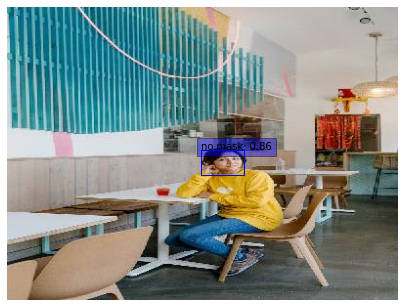

<AxesSubplot:>

In [ ]:
#@title Infer on a Specific Image
image_path = "im12.jpg" #@param {type: "string"}
image = plt.imread(image_path)
start_time = time.time() #start time
image = tf.cast(image, dtype=tf.float32)
input_image, ratio = prepare_image(image)
detections = inference_model.predict(input_image)
print("Inference Time (s) for 1 image: ", (time.time() - start_time)) #end time
num_detections = detections.valid_detections[0]
class_names = [
    condition_key[int(x)] for x in detections.nmsed_classes[0][:num_detections]
]
visualize_detections(
    image,
    detections.nmsed_boxes[0][:num_detections] / ratio,
    class_names,
    detections.nmsed_scores[0][:num_detections],
)